In [95]:
#%pip install -r requirements.txt
#%pip install --upgrade jupyter
#%pip install --upgrade ipywidgets

'\n!pip install -r requirements.txt\n!pip install --upgrade jupyter\n!pip install --upgrade ipywidgets\n'

In [41]:
import matplotlib
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import json
import csv
import time
import re
import requests
import warnings
from datetime import datetime
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error, mean_absolute_error
from sklearn.preprocessing import StandardScaler, RobustScaler, PowerTransformer, Normalizer, MinMaxScaler, MaxAbsScaler, QuantileTransformer
from sklearn.preprocessing import KBinsDiscretizer, LabelEncoder
from sklearn.ensemble import GradientBoostingRegressor, HistGradientBoostingRegressor
from sklearn.ensemble import RandomForestClassifier, HistGradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import LinearSVR, LinearSVC
from sklearn.impute import SimpleImputer
from lightgbm import LGBMClassifier, LGBMRegressor
from xgboost import XGBClassifier, XGBRegressor
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from scipy.stats import randint, uniform, loguniform, zscore
from sklearn.utils import resample
import optuna
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, classification_report, make_scorer
from statsmodels.nonparametric.smoothers_lowess import lowess
import joblib
import logging
#warnings.filterwarnings('ignore')

# Configuración de la ruta del archivo CSV
songs_file_path = 'docs\\600k_tracks_anonimous.csv'
file_path = 'logs\hyperparameters__LGBMRegressor_GridSearchCV_df.csv' 
logs_folder = "logs"
if not os.path.exists(logs_folder):
    os.makedirs(logs_folder)
log_file_prefix = os.path.join(logs_folder, "hyperparameters_")
scaler_config_file = os.path.join(logs_folder, "scaler_config.csv")

# Configuración para visualizaciones en Jupyter Notebook
%matplotlib inline
sns.set(style="whitegrid")
pd.set_option('display.max_columns', None)

songs_df = pd.read_csv(songs_file_path)
df = pd.read_csv(file_path)
df.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_model__learning_rate,param_model__max_depth,param_model__n_estimators,param_model__num_leaves,params,split0_test_neg_mean_squared_error,split1_test_neg_mean_squared_error,split2_test_neg_mean_squared_error,split3_test_neg_mean_squared_error,split4_test_neg_mean_squared_error,mean_test_neg_mean_squared_error,std_test_neg_mean_squared_error,rank_test_neg_mean_squared_error,split0_test_r2,split1_test_r2,split2_test_r2,split3_test_r2,split4_test_r2,mean_test_r2,std_test_r2,rank_test_r2,split0_test_explained_variance,split1_test_explained_variance,split2_test_explained_variance,split3_test_explained_variance,split4_test_explained_variance,mean_test_explained_variance,std_test_explained_variance,rank_test_explained_variance,split0_test_neg_mean_absolute_error,split1_test_neg_mean_absolute_error,split2_test_neg_mean_absolute_error,split3_test_neg_mean_absolute_error,split4_test_neg_mean_absolute_error,mean_test_neg_mean_absolute_error,std_test_neg_mean_absolute_error,rank_test_neg_mean_absolute_error
0,150.551075,1.338445,0.250747,0.041775,0.1,NaN,100,15,"{'model__learning_rate': 0.1, 'model__max_dept...",-223.710835,-222.695176,-226.601508,-223.131674,-225.725047,-224.372848,1.522414,7,0.332492,0.332211,0.326403,0.332772,0.325143,0.329804,0.003320,7,0.332507,0.332211,0.326437,0.332819,0.325149,0.329825,0.003322,7,-11.921320,-11.863883,-12.015106,-11.917502,-11.968818,-11.937326,0.051156,7
1,201.855625,1.346665,0.215527,0.031860,0.1,NaN,100,20,"{'model__learning_rate': 0.1, 'model__max_dept...",-222.319122,-221.815287,-225.371951,-221.984858,-224.122863,-223.122816,1.393500,6,0.336645,0.334849,0.330058,0.336201,0.329933,0.333537,0.002952,6,0.336664,0.334849,0.330087,0.336251,0.329937,0.333558,0.002957,6,-11.859257,-11.826925,-11.957975,-11.873316,-11.908556,-11.885206,0.044838,6
2,263.220254,26.005227,0.205328,0.022240,0.1,NaN,100,25,"{'model__learning_rate': 0.1, 'model__max_dept...",-221.458460,-220.412865,-224.461263,-221.525140,-223.250198,-222.221585,1.443126,5,0.339213,0.339054,0.332766,0.337576,0.332542,0.336230,0.002976,5,0.339234,0.339055,0.332798,0.337618,0.332548,0.336251,0.002975,5,-11.826458,-11.774013,-11.929328,-11.848132,-11.874553,-11.850497,0.051432,5
3,300.949421,2.676808,0.246862,0.067318,0.1,NaN,100,30,"{'model__learning_rate': 0.1, 'model__max_dept...",-220.157441,-219.463024,-223.707100,-220.535264,-222.511271,-221.274820,1.582585,4,0.343095,0.341903,0.335007,0.340536,0.334751,0.339058,0.003508,4,0.343117,0.341904,0.335036,0.340575,0.334754,0.339077,0.003509,4,-11.787049,-11.742590,-11.905141,-11.822517,-11.846794,-11.820818,0.054860,4
4,346.458858,3.969472,0.275932,0.062165,0.1,NaN,100,35,"{'model__learning_rate': 0.1, 'model__max_dept...",-220.012913,-218.905135,-223.214535,-219.987529,-222.178393,-220.859701,1.586332,3,0.343526,0.343576,0.336472,0.342174,0.335746,0.340299,0.003465,3,0.343555,0.343576,0.336505,0.342216,0.335751,0.340320,0.003467,3,-11.763646,-11.722892,-11.887062,-11.797243,-11.831010,-11.800371,0.056241,3


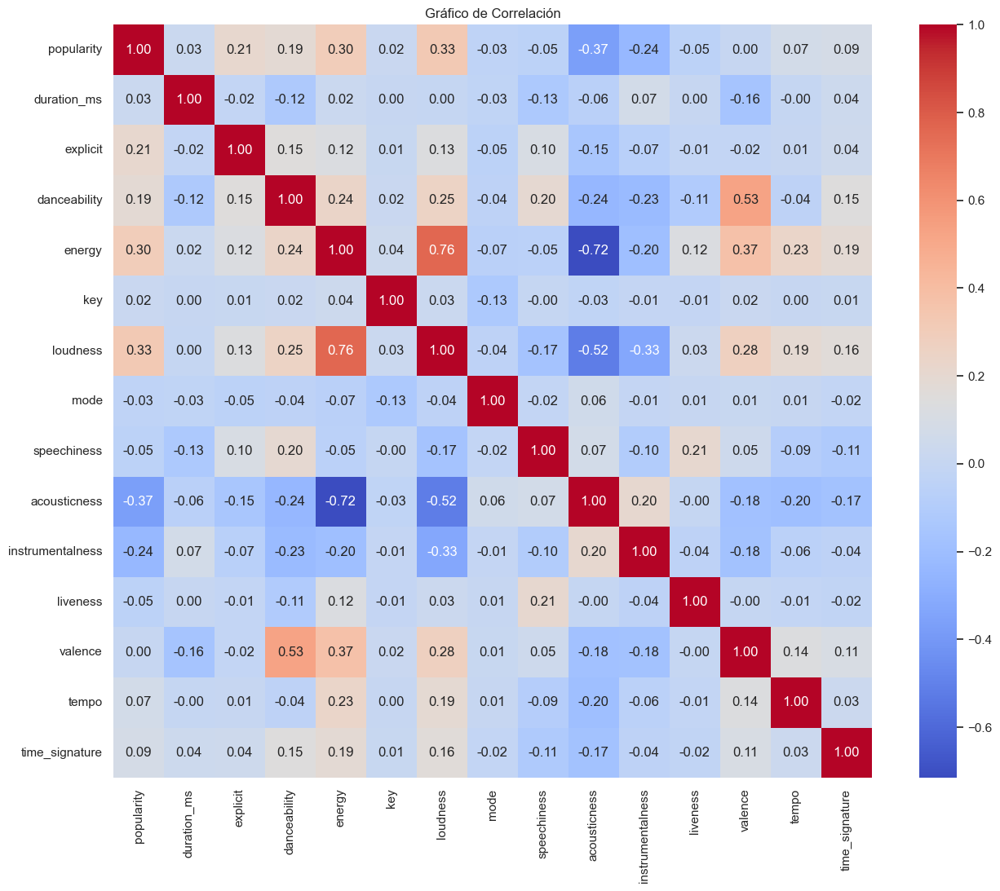

In [3]:
corr_matrix = songs_df.corr()

plt.figure(figsize=(15, 12))  
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Gráfico de Correlación')
plt.show()

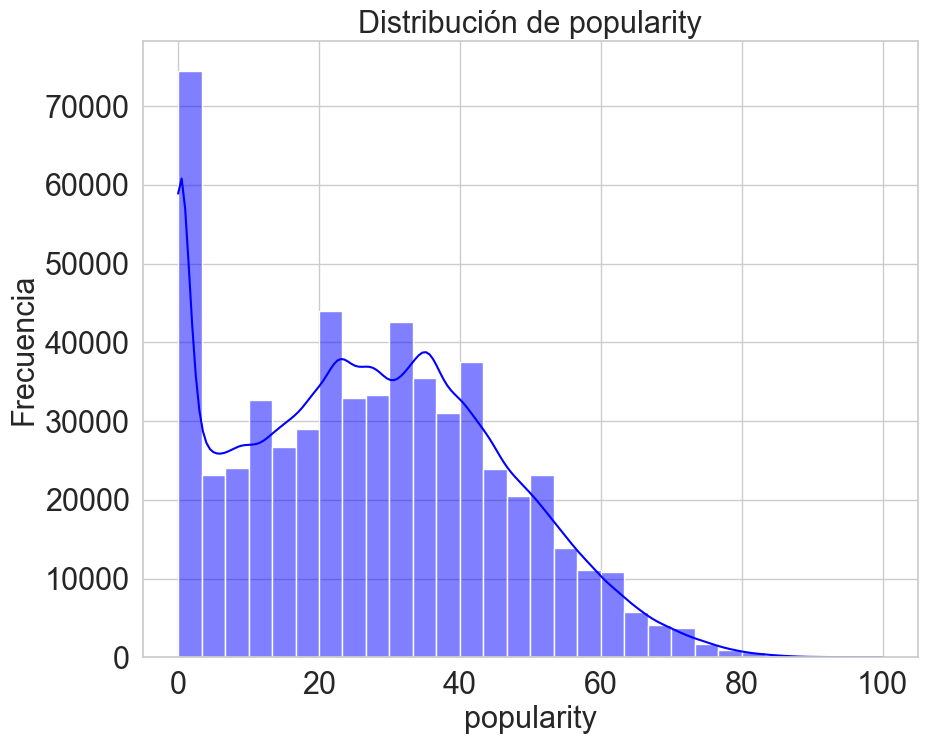

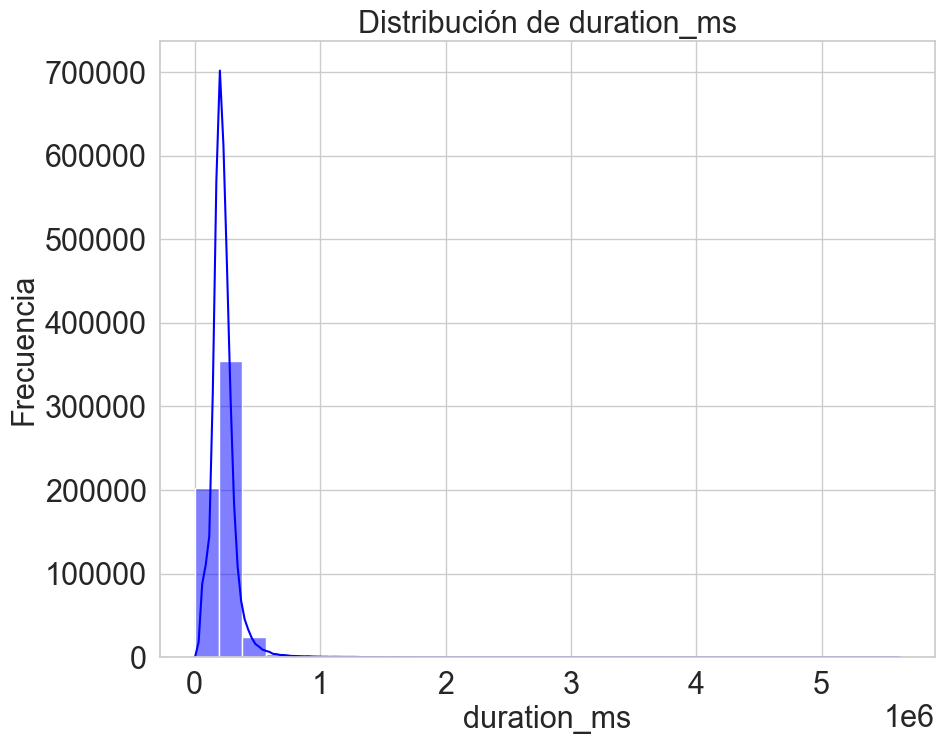

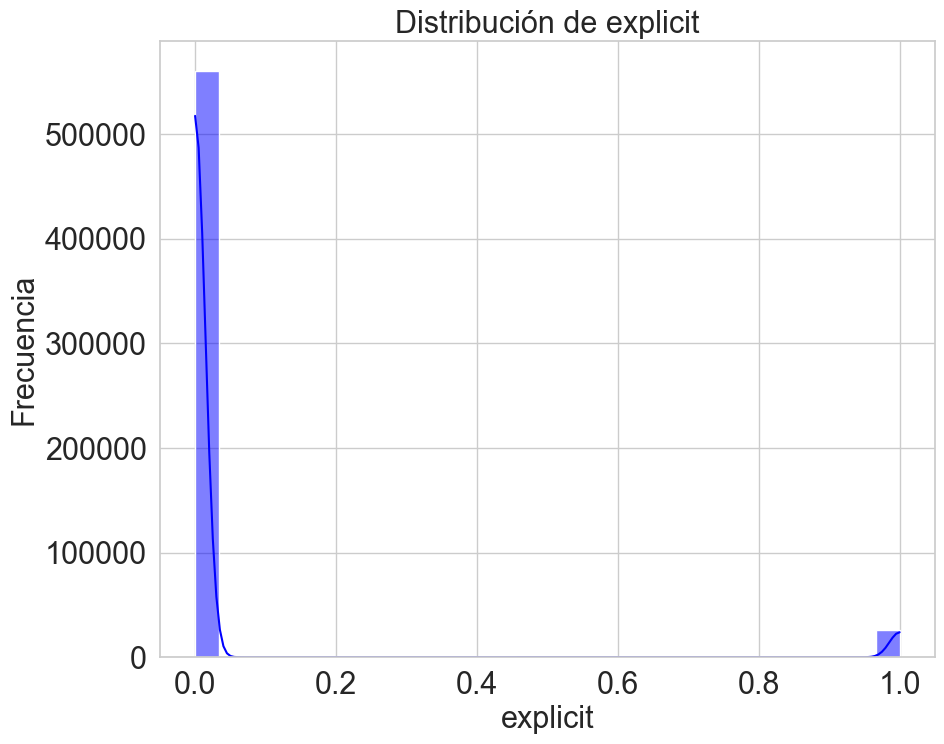

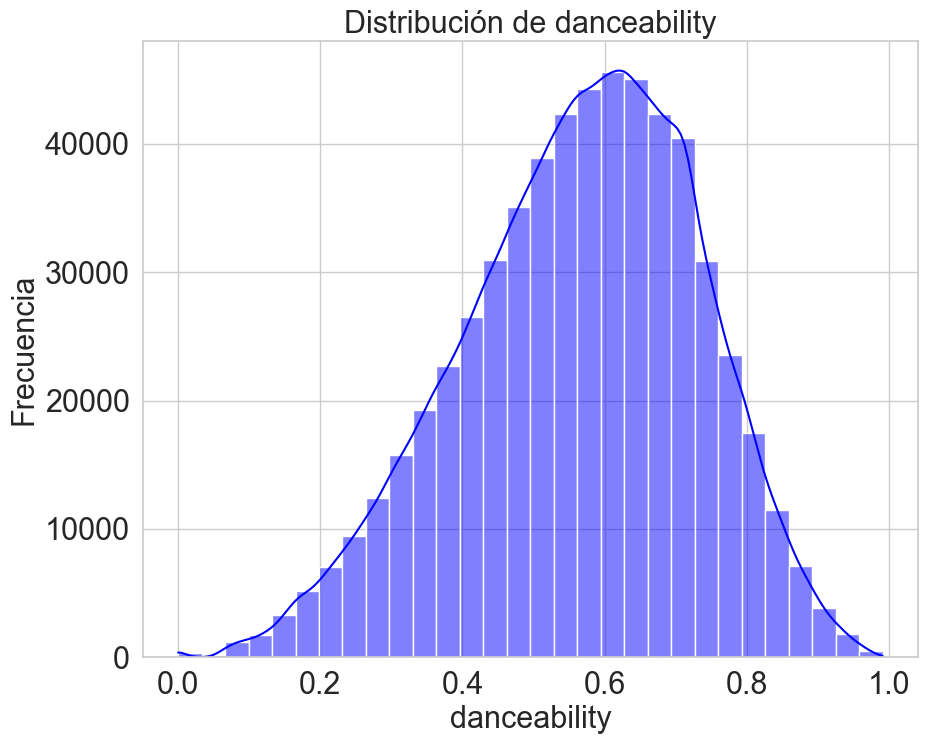

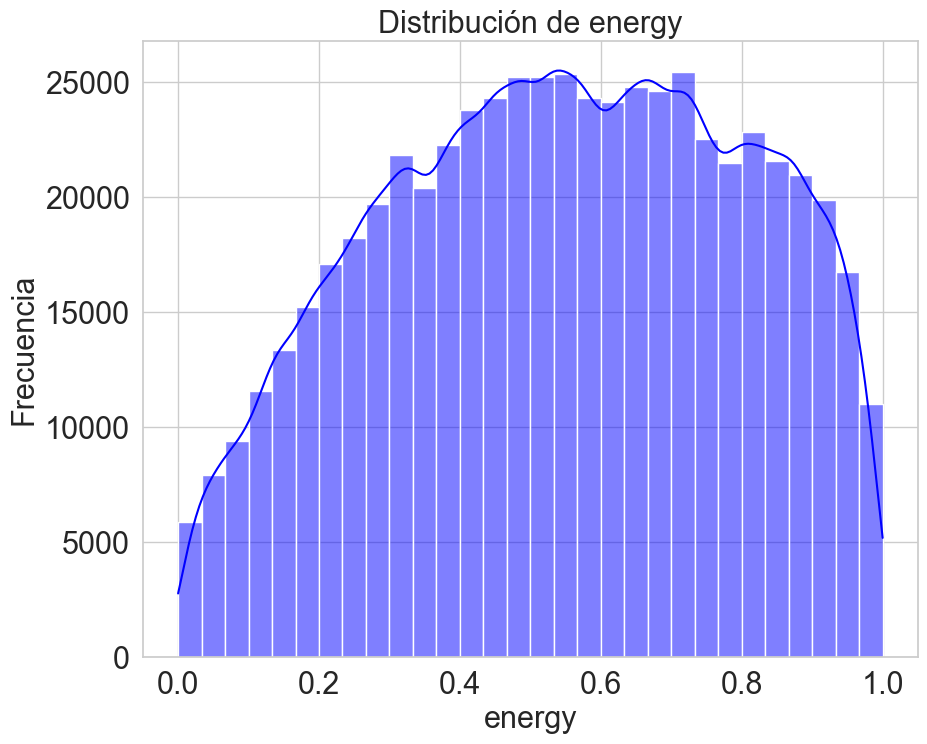

...

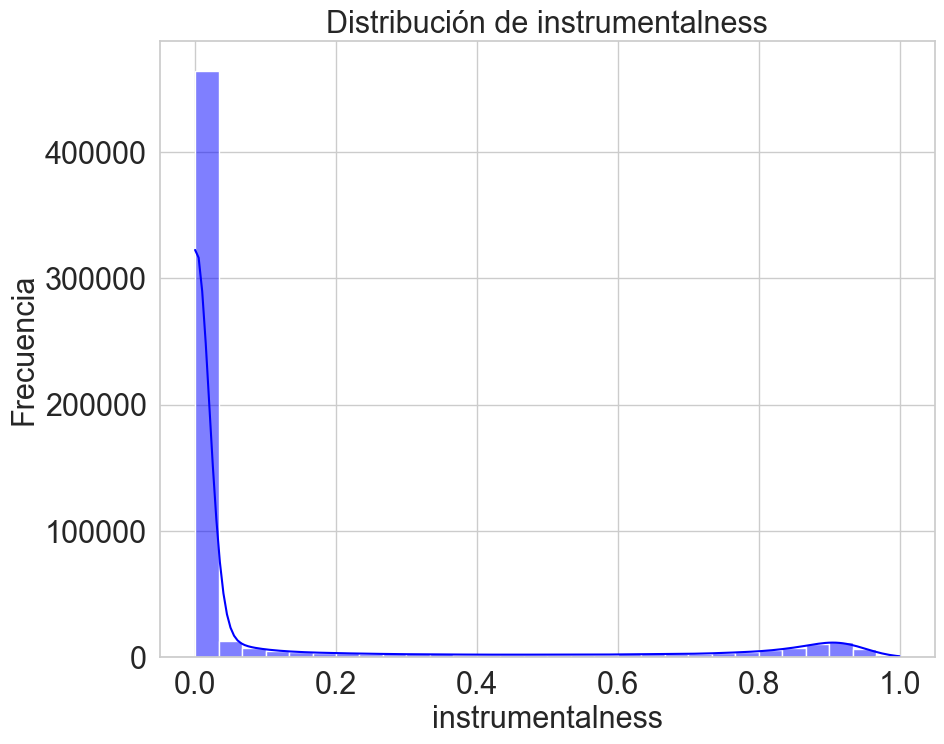

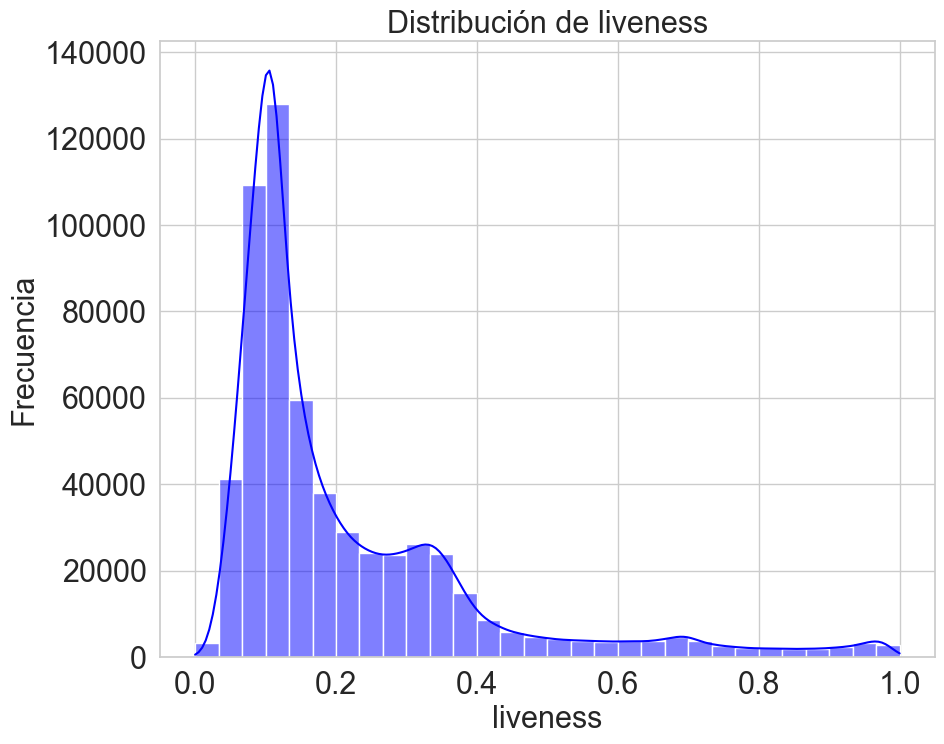

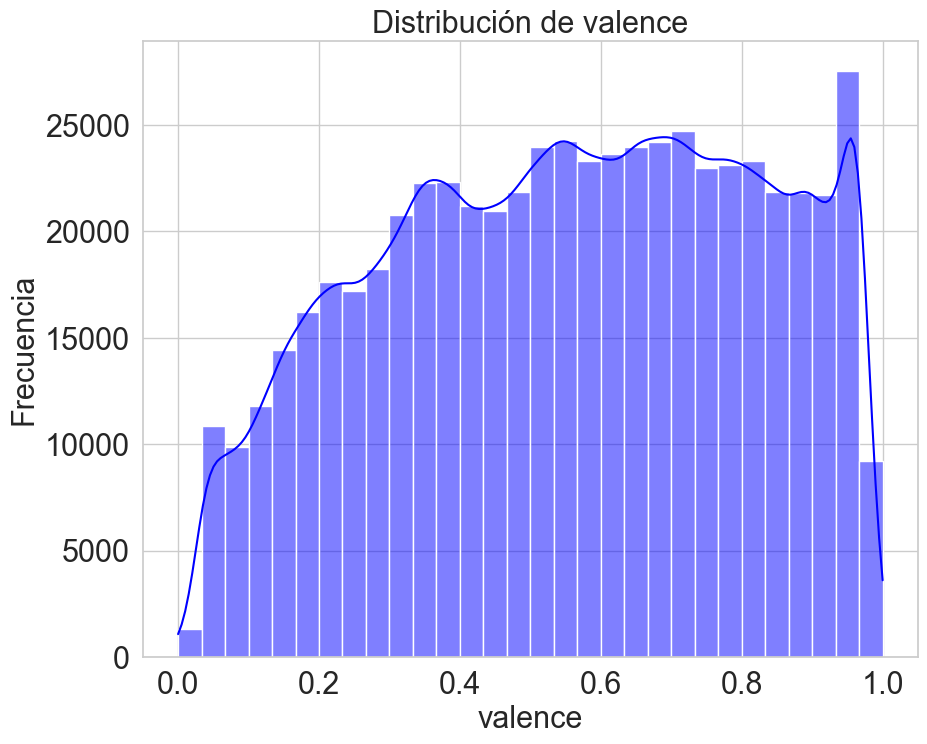

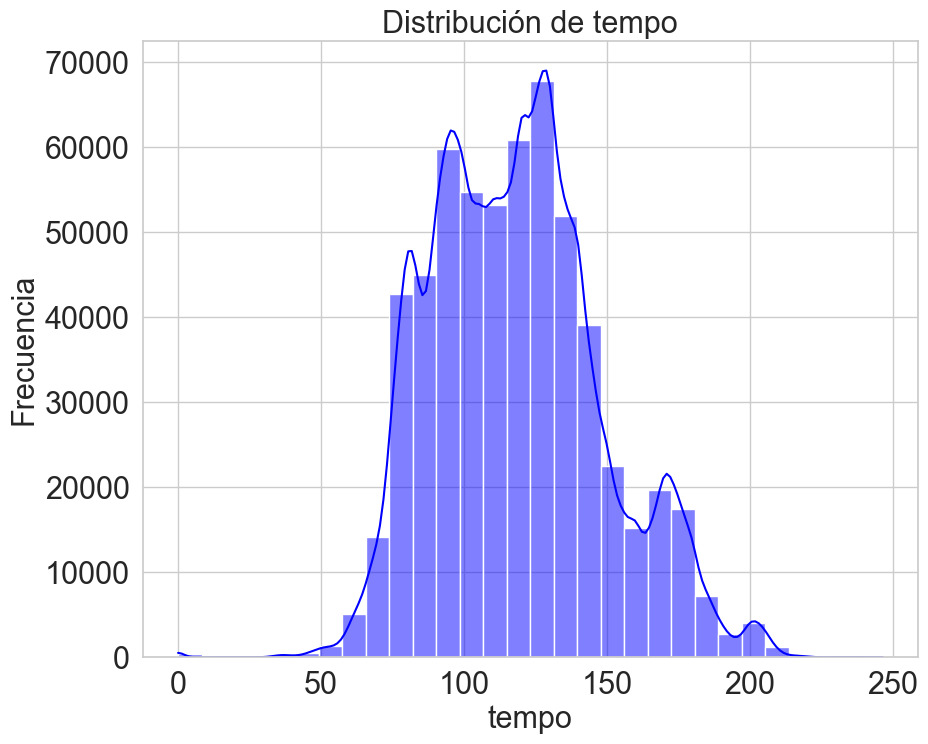

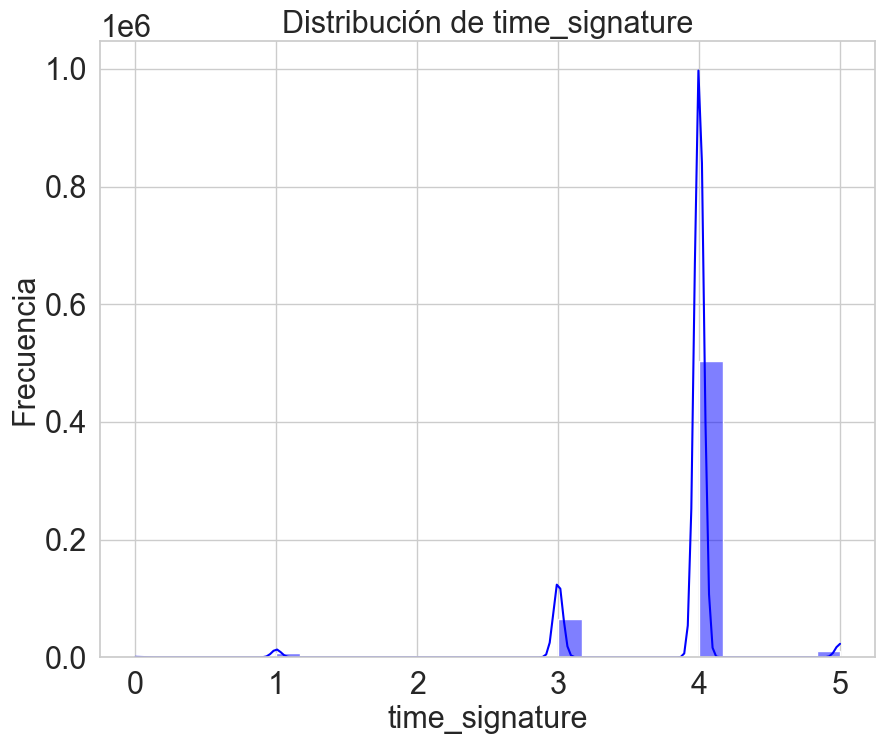

In [42]:
def plot_and_save_histograms(data, output_dir):
    os.makedirs(output_dir, exist_ok=True)
    
    # font size configuration
    plt.rc('font', size=22)  
    plt.rc('axes', titlesize=22)  
    plt.rc('axes', labelsize=22)  
    plt.rc('xtick', labelsize=22) 
    plt.rc('ytick', labelsize=22)  
    plt.rc('legend', fontsize=22)  
    plt.rc('figure', titlesize=22) 
    data = data.replace('NaN', 0)

    for col in data.columns:
        plt.figure(figsize=(10, 8))  
        sns.histplot(data[col], bins=30, kde=True, color='blue')

        plt.gca().set(ylim=(0, None))

        plt.title(f'Distribución de {col}')
        plt.xlabel(col)
        plt.ylabel('Frecuencia')

        plt.show()

        output_path = os.path.join(output_dir, f'{col}_histogram.png')
        plt.savefig(output_path)

        plt.close()

plot_and_save_histograms(songs_df, 'images')

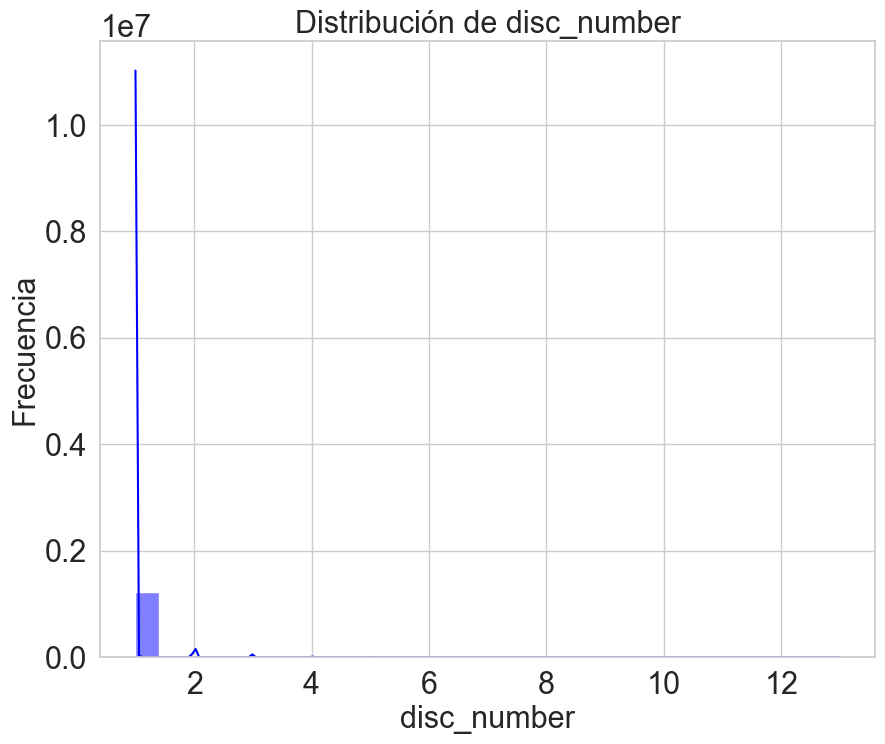

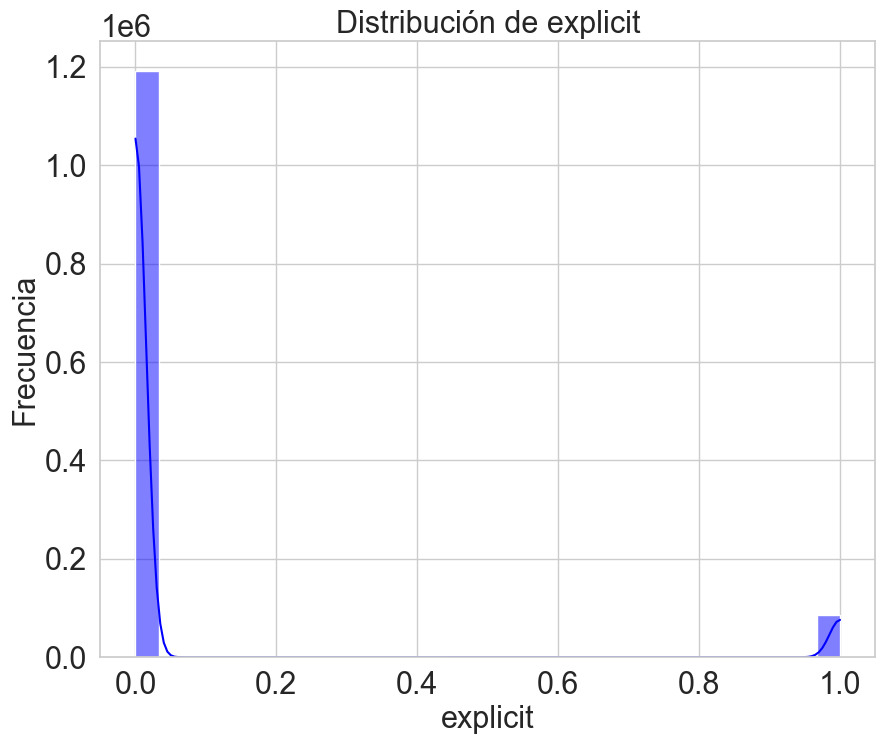

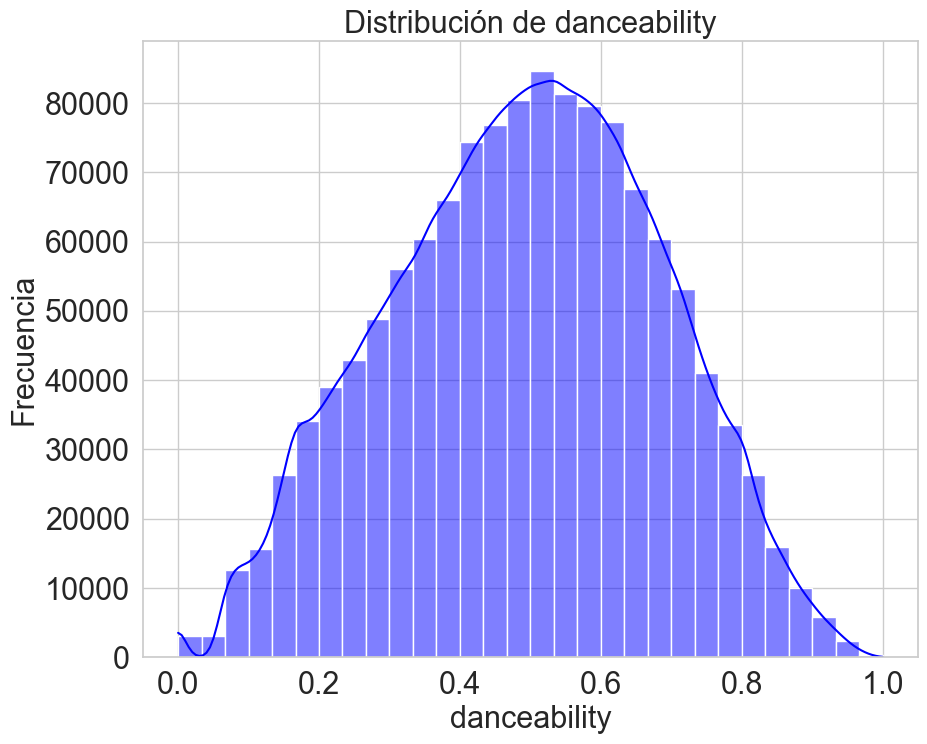

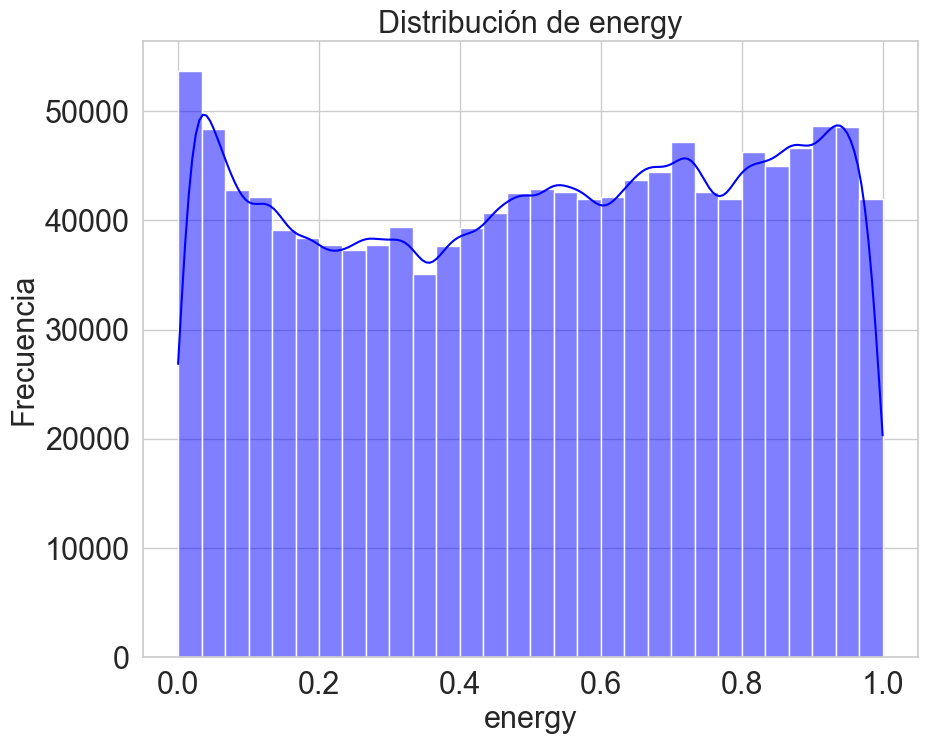

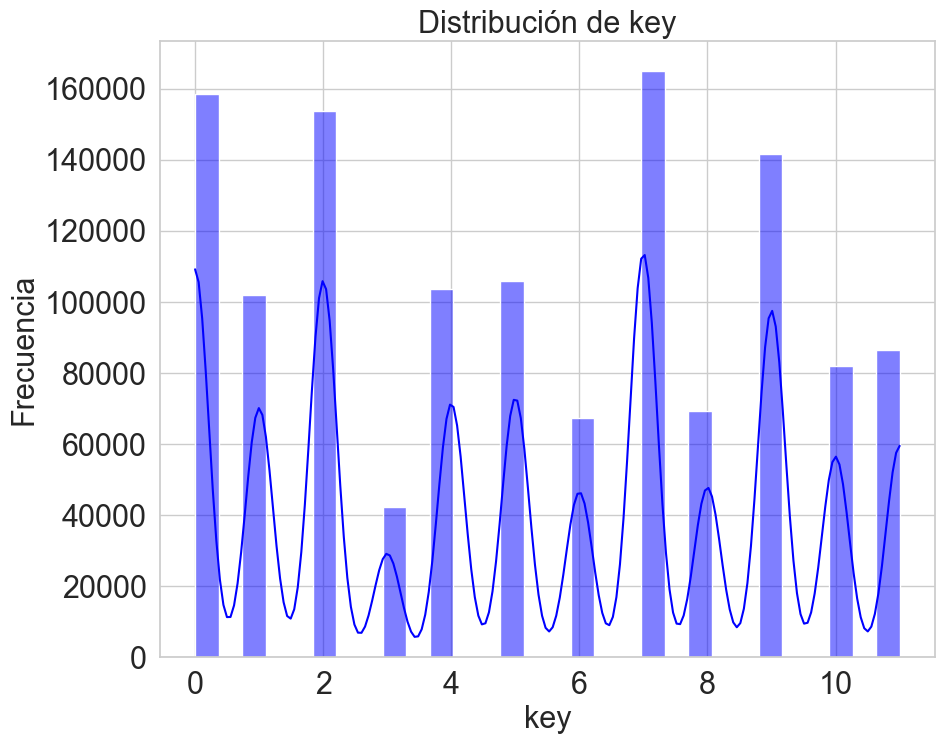

...

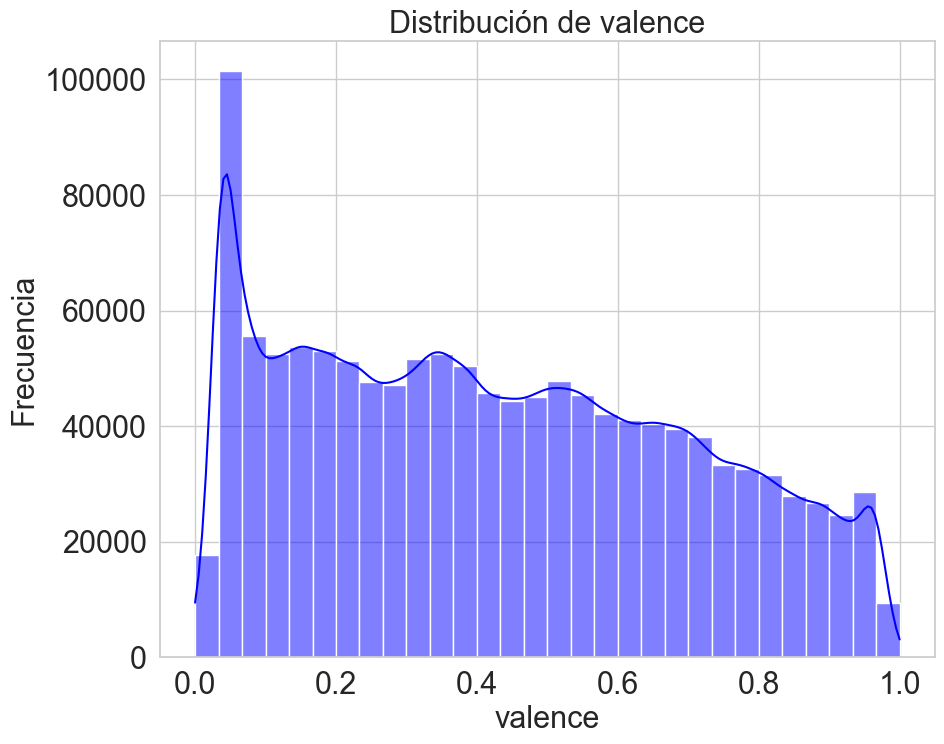

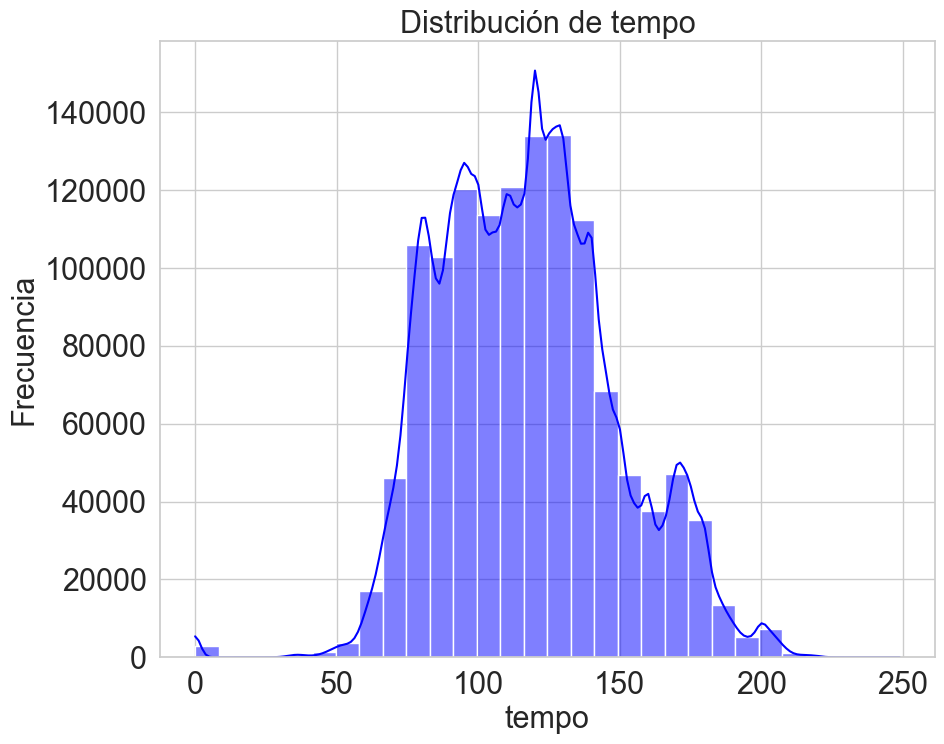

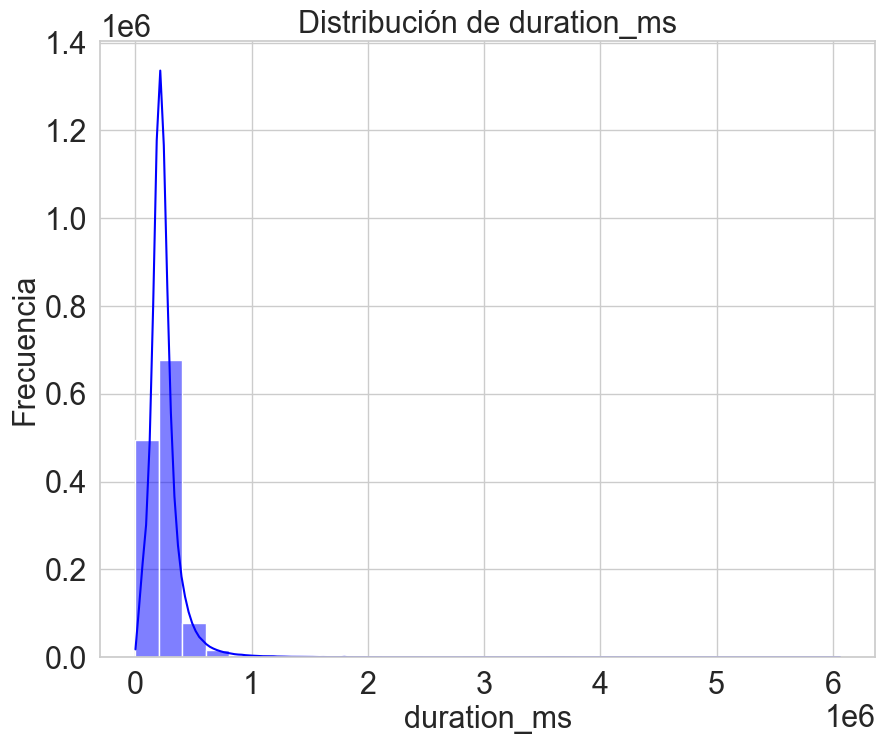

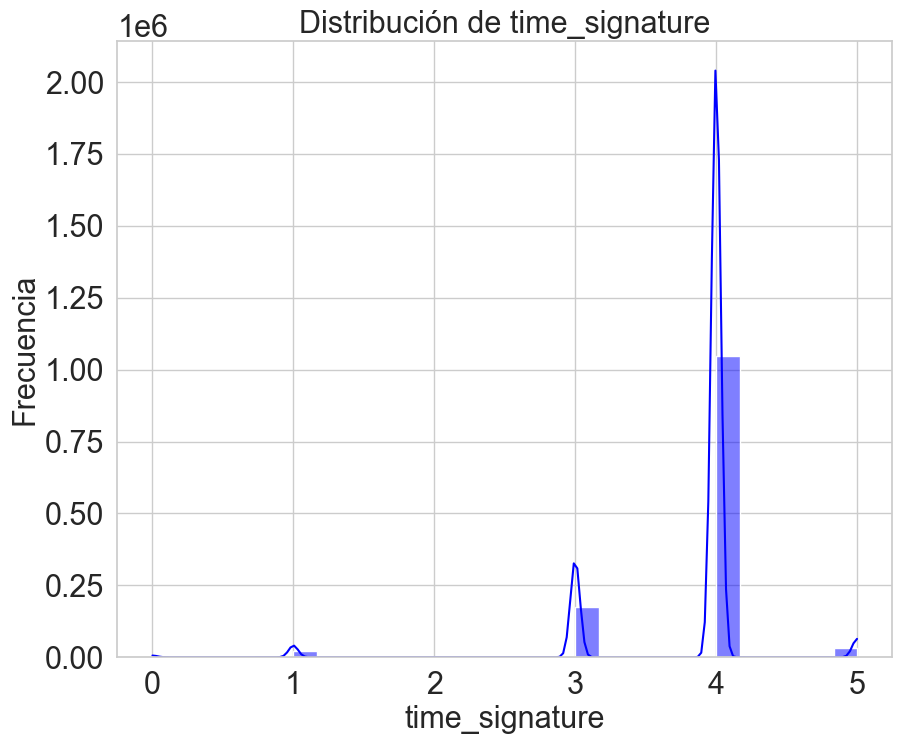

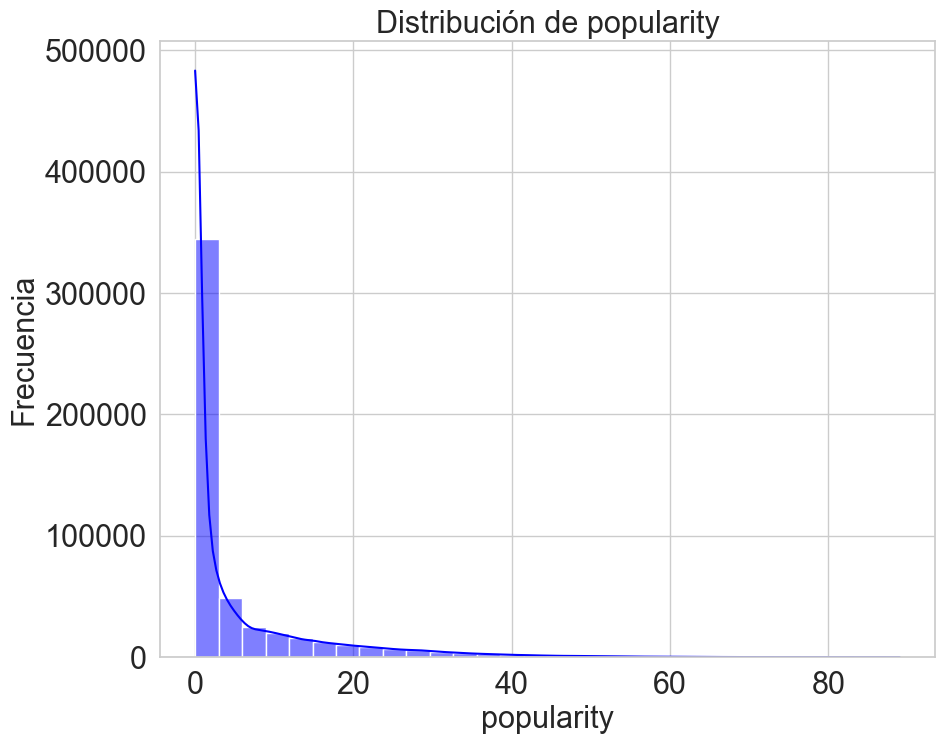

In [39]:
songs_file_path = 'docs\\tracks_properties_anon_noyear.csv'
songs_df = pd.read_csv(songs_file_path)
plot_and_save_histograms(songs_df, 'images')

In [37]:
sin_popularidad = songs_df['popularity'].isnull().sum()
print(f"Número de filas sin popularidad: {sin_popularidad}")

Número de filas sin popularidad: 759789


In [44]:
print(songs_df.shape)
for i in range(0, 10):
    lower_bound = i * 10
    upper_bound = (i + 1) * 10
    num_popular_items = len(songs_df[(songs_df['popularity'] >= lower_bound) & (songs_df['popularity'] < upper_bound)])
    print(f"Número de elementos entre {lower_bound} y {upper_bound} de popularidad:", num_popular_items)
print(songs_df.shape[0])

(586672, 15)
Número de elementos entre 0 y 10 de popularidad: 121608
Número de elementos entre 10 y 20 de popularidad: 88282
Número de elementos entre 20 y 30 de popularidad: 110211
Número de elementos entre 30 y 40 de popularidad: 108941
Número de elementos entre 40 y 50 de popularidad: 81787
Número de elementos entre 50 y 60 de popularidad: 47999
Número de elementos entre 60 y 70 de popularidad: 20521
Número de elementos entre 70 y 80 de popularidad: 6369
Número de elementos entre 80 y 90 de popularidad: 905
Número de elementos entre 90 y 100 de popularidad: 48
586672


In [5]:
print(songs_df.shape)

(1278314, 16)


In [4]:
def print_regression_metrics(y_test, predictions):
    mse = mean_squared_error(y_test, predictions)
    r2 = r2_score(y_test, predictions)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, predictions)
    mape = mean_absolute_percentage_error(y_test, predictions)
    mse_var = mse / np.var(y_test)
    
    print(f'Mean Squared Error: {mse}')
    print(f'R2 Score: {r2}')
    print(f'Root Mean Squared Error (RMSE): {rmse}')
    print(f'Mean Absolute Error (MAE): {mae}')
    print(f'Mean Absolute Percentage Error (MAPE): {mape}')
    print(f'MSE to Variance Ratio: {mse_var}')


In [5]:
def filter_and_sort(df, sort_by_column='mean_test_neg_mean_squared_error', ascending=True):
    
    param_model_columns = df.filter(like='param_model').columns
    aggregate_metric_columns = df.filter(regex=r'^(?!.*split)(?!.*rank_)(?!.*std_).*$').columns
    selected_columns = list(set(param_model_columns) | set(aggregate_metric_columns))
    df_selected = df[selected_columns]
    df_sorted = df_selected.sort_values(by=sort_by_column, ascending=ascending)

    return df_sorted

def select_and_rename_columns(df, sort_by_column='neg_mean_squared_error', sort = False, ascending=True, remove_duplicates=True):
    if remove_duplicates:
        df = df.drop_duplicates(subset=df.filter(like='param_model__').columns, keep='first')

    selected_columns = df.filter(regex=r'^param_model__|^mean_test_|^mean_fit_time').columns
    new_column_names = [col.replace('param_model__', '').replace('mean_test_', '').replace('mean_fit_time', 'fit_time') for col in selected_columns]
    column_mapping = dict(zip(selected_columns, new_column_names))

    df_selected = df[selected_columns].rename(columns=column_mapping)
    if not sort: return df_selected

    if sort_by_column in df_selected.columns:
        df_sorted = df_selected.sort_values(by=sort_by_column, ascending=ascending)
        return df_sorted
    else:
        print(f"La columna '{sort_by_column}' especificada para ordenar no está presente en el DataFrame después de las transformaciones.")
        return None

In [6]:
def process_logs(directory="logs/"):
    files = os.listdir(directory)

    files = [file for file in files if not (file.endswith("log.csv")or file.endswith("GridSearchCV_df.csv"))]

    for file in files:
        if file.startswith("hyperparameters_"):
            input_file = os.path.join(directory, file)
            print("\n\n", input_file)

            output_name = file.replace("hyperparameters_", "")
            output_file = os.path.join("analisis", output_name)
            df = pd.read_csv(input_file)

            df_processed = select_and_rename_columns(df)
            df_processed.to_csv(output_file, index=False)

            print(f"Archivo procesado: {input_file} -> {output_file}")


In [7]:
#process_logs()

In [8]:
df_hyperparameters = pd.read_csv('analisis\_LinearRegression_df.csv')

In [22]:

# df2 = filter_and_sort(df, ascending=False)
df_selected = select_and_rename_columns(df, sort_by_column='neg_mean_squared_error', ascending=True)

df_selected.to_csv('analisis\\LGBMRegressor_Gridsearch.csv', index=False)


ValueError: not enough values to unpack (expected 2, got 0)

In [41]:
def plot_and_save_scatterplots(data, output_dir = "images/", algorithm = "", comparison_column="fit_time",
                                excluded_columns=["fit_time", "neg_mean_squared_error", "r2", "explained_variance", "neg_mean_absolute_error", 
                                                "balanced_accuracy", "accuracy", "f1_weighted", "precision_weighted", "recall_weighted"], 
                                polynomial_degree=10):

    os.makedirs(output_dir, exist_ok=True)

    sns.set(style="whitegrid")
    sns.set_context("notebook", font_scale=2.4)
    
    columns_to_plot = [col for col in data.columns if col not in excluded_columns]
    
    for col in columns_to_plot:
        if data[col].dtype == 'object' or data[col].dtype == 'bool':
            plt.figure(figsize=(10, 8))  
            sns.scatterplot(data=data, x=col, y=comparison_column)
        else:
            plt.figure(figsize=(10, 8))  
            sns.regplot(data=data, x=col, y=comparison_column, order=polynomial_degree, line_kws={"color": "red"})
        
        comparison_column_ = comparison_column.replace("_", " ").title()
        col_ = col.replace("_", " ").title()
        plt.title(f'{col_} vs {comparison_column_}')
        plt.xlabel(algorithm+": "+col_)
        plt.ylabel(comparison_column_)
        
        plt.tight_layout()
        plt.show()
        
        output_path = os.path.join(output_dir, f'{algorithm}_{col}_vs_{comparison_column}_scatterplot.png')
        plt.savefig(output_path)
        plt.close()

def plot_and_save_scatterplots2(data, output_dir="images/", algorithm="", comparison_columns=["fit_time", "neg_mean_squared_error"],
                                excluded_columns=["fit_time", "neg_mean_squared_error", "r2", "explained_variance", "neg_mean_absolute_error", 
                                                "balanced_accuracy", "accuracy", "f1_weighted", "precision_weighted", "recall_weighted"], 
                                polynomial_degree=10):
    os.makedirs(output_dir, exist_ok=True)
    
    sns.set(style="whitegrid")
    sns.set_context("notebook", font_scale=2.4)
    
    columns_to_plot = [col for col in data.columns if col not in excluded_columns]
    
    for col1 in columns_to_plot:
        for col2 in comparison_columns:
            if col1 != col2:
                if data[col1].dtype != 'object' and data[col1].dtype != 'bool' and data[col2].dtype != 'object' and data[col2].dtype != 'bool':
                    plt.figure(figsize=(10, 8))  
                    sns.regplot(data=data, x=col1, y=col2, order=polynomial_degree, line_kws={"color": "red"})
                    
                    col1_ = col1.replace("_", " ").title()
                    col2_ = col2.replace("_", " ").title()
                    plt.title(f'{col1_} vs {col2_}')
                    plt.xlabel(algorithm + ": " + col1_)
                    plt.ylabel(col2_)
                    
                    plt.tight_layout()
                    plt.show()
                    
                    output_path = os.path.join(output_dir, f'{algorithm}_{col1}_vs_{col2}_scatterplot.png')
                    plt.savefig(output_path)
                    plt.close()


def plot_and_save_scatterplots3(data, output_dir="images/", algorithm="", comparison_columns=["fit_time", "neg_mean_squared_error"],
                                excluded_columns=["fit_time", "neg_mean_squared_error", "r2", "explained_variance", "neg_mean_absolute_error", 
                                                "balanced_accuracy", "accuracy", "f1_weighted", "precision_weighted", "recall_weighted"], 
                                polynomial_degree=10):
    os.makedirs(output_dir, exist_ok=True)
    
    sns.set(style="whitegrid")
    sns.set_context("notebook", font_scale=2.4)
    
    columns_to_plot = [col for col in data.columns if col not in excluded_columns]
    
    data_copy = data.copy()
    
    for col in columns_to_plot:
        if data_copy[col].isnull().values.any():
            data_copy[col] = data_copy[col].astype(str).replace("nan", "NaN")
        
        if data_copy[col].dtype == 'object' or data_copy[col].dtype == 'bool':
            plt.figure(figsize=(20, 8))  
            plt.subplot(1, 2, 1)  
            sns.scatterplot(data=data_copy, x=col, y="fit_time")
            plt.title(f'{col.title().replace("_", " ")} vs Fit Time')
            plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
            plt.ylabel("Fit Time")
            
            plt.subplot(1, 2, 2)  
            sns.scatterplot(data=data_copy, x=col, y="neg_mean_squared_error")
            plt.title(f'{col.title().replace("_", " ")} vs Negative Mean Squared Error')
            plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
            plt.ylabel("Negative Mean Squared Error")
            
        else:
            plt.figure(figsize=(20, 8))  
            plt.subplot(1, 2, 1)  
            sns.regplot(data=data_copy, x=col, y="fit_time", order=polynomial_degree, line_kws={"color": "red"})
            plt.title(f'{col.title().replace("_", " ")} vs Fit Time')
            plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
            plt.ylabel("Fit Time")
            
            plt.subplot(1, 2, 2)  
            sns.regplot(data=data_copy, x=col, y="neg_mean_squared_error", order=polynomial_degree, line_kws={"color": "red"})
            plt.title(f'{col.title().replace("_", " ")} vs Negative Mean Squared Error')
            plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
            plt.ylabel("Negative Mean Squared Error")
            
        plt.tight_layout()
        
        output_path = os.path.join(output_dir, f'{algorithm}_{col}_scatterplots.png')
        plt.savefig(output_path)
        plt.show()
        plt.close()


def plot_and_save_scatterplots_median(data, output_dir="images/", algorithm="",
                                excluded_columns=["fit_time", "neg_mean_squared_error", "r2", "explained_variance", "neg_mean_absolute_error", 
                                                "balanced_accuracy", "accuracy", "f1_weighted", "precision_weighted", "recall_weighted"], 
                                frac=0.03):

    os.makedirs(output_dir, exist_ok=True)
    
    sns.set(style="whitegrid")
    
    sns.set_context("notebook", font_scale=2.4)
    
    columns_to_plot = [col for col in data.columns if col not in excluded_columns]

    data_copy = data.copy()

    for col in columns_to_plot:
        if data_copy[col].isnull().values.any():
            data_copy[col] = data_copy[col].astype(str).replace("nan", "NaN")
        
        if data_copy[col].dtype == 'object' or data_copy[col].dtype == 'bool':
            plt.figure(figsize=(20, 8))  
            plt.subplot(1, 2, 1) 
            sns.scatterplot(data=data_copy, x=col, y="fit_time")
            plt.title(f'{col.title().replace("_", " ")} vs Fit Time')
            plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
            plt.ylabel("Fit Time")
            
            plt.subplot(1, 2, 2)  
            sns.scatterplot(data=data_copy, x=col, y="neg_mean_squared_error")
            plt.title(f'{col.title().replace("_", " ")} vs Negative Mean Squared Error')
            plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
            plt.ylabel("Negative Mean Squared Error")
            
        else:
            plt.figure(figsize=(20, 8))  
            plt.subplot(1, 2, 1)
            sns.scatterplot(data=data_copy, x=col, y="fit_time")
            smoothed_fit_time = lowess(data_copy["fit_time"], data_copy[col], frac=frac)
            plt.plot(smoothed_fit_time[:, 0], smoothed_fit_time[:, 1], color='red', lw=2)
            plt.title(f'{col.title().replace("_", " ")} vs Fit Time')
            plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
            plt.ylabel("Fit Time")
            
            plt.subplot(1, 2, 2)
            sns.scatterplot(data=data_copy, x=col, y="neg_mean_squared_error")
            smoothed_mse = lowess(data_copy["neg_mean_squared_error"], data_copy[col], frac=frac)
            plt.plot(smoothed_mse[:, 0], smoothed_mse[:, 1], color='red', lw=2)
            plt.title(f'{col.title().replace("_", " ")} vs Negative Mean Squared Error')
            plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
            plt.ylabel("Negative Mean Squared Error")
            
        plt.tight_layout()
        
        output_path = os.path.join(output_dir, f'{algorithm}_{col}_scatterplots.png')
        plt.savefig(output_path)
        plt.show()
        plt.close()

def plot_and_save_scatterplots_median_and_reg_pol(data, output_dir="images/", algorithm="",
                                excluded_columns=["fit_time", "neg_mean_squared_error", "r2", "explained_variance", "neg_mean_absolute_error", 
                                                "balanced_accuracy", "accuracy", "f1_weighted", "precision_weighted", "recall_weighted"], 
                                frac=0.05, polynomial_degree=10, regression=True, lw = 4, only_median_plots=False):

    os.makedirs(output_dir, exist_ok=True)
    
    sns.set(style="whitegrid")
    sns.set_context("notebook", font_scale=2.4)
    
    columns_to_plot = [col for col in data.columns if col not in excluded_columns]
    
    data_copy = data.copy()
    
    for col in columns_to_plot:
        if data_copy[col].isnull().values.any():
            data_copy[col] = data_copy[col].astype(str).replace("nan", "None")
        
        if data_copy[col].dtype == 'object' or data_copy[col].dtype == 'bool' or only_median_plots:
            plt.figure(figsize=(20, 8))  
            plt.subplot(1, 2, 1) 
            sns.scatterplot(data=data_copy, x=col, y="fit_time")
            plt.title(f'{col.title().replace("_", " ")} vs Fit Time')
            plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
            plt.ylabel("Fit Time")

            for value in data_copy[col].unique():
                mean_fit_time = data_copy[data_copy[col] == value]["fit_time"].mean()
                plt.scatter(value, mean_fit_time, color='red', s=100)

            if regression:
                plt.subplot(1, 2, 2)
                sns.scatterplot(data=data_copy, x=col, y="neg_mean_squared_error")
                plt.title(f'{col.title().replace("_", " ")} vs Negative Mean Squared Error')
                plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
                plt.ylabel("Negative Mean Squared Error")

                for value in data_copy[col].unique():
                    mean_error = data_copy[data_copy[col] == value]["neg_mean_squared_error"].mean()
                    plt.scatter(value, mean_error, color='red', s=100)

            else: 
                plt.subplot(1, 2, 2) 
                sns.scatterplot(data=data_copy, x=col, y="balanced_accuracy")
                plt.title(f'{col.title().replace("_", " ")} vs Balanced Accuracy')
                plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
                plt.ylabel("Balanced Accuracy")

                for value in data_copy[col].unique():
                    mean_accuracy = data_copy[data_copy[col] == value]["balanced_accuracy"].mean()
                    plt.scatter(value, mean_accuracy, color='red', s=100)
            
        else:
            plt.figure(figsize=(20, 8))
            plt.subplot(1, 2, 1)
            sns.scatterplot(data=data_copy, x=col, y="fit_time")
            smoothed_fit_time = lowess(data_copy["fit_time"], data_copy[col], frac=frac)
            sns.regplot(data=data_copy, x=col, y="fit_time", order=polynomial_degree, line_kws={"color": "green", "linewidth": lw})
            plt.plot(smoothed_fit_time[:, 0], smoothed_fit_time[:, 1], color='red', lw=lw)
            plt.title(f'{col.title().replace("_", " ")} vs Fit Time')
            plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
            plt.ylabel("Fit Time")
            
            if regression:
                plt.subplot(1, 2, 2)
                sns.scatterplot(data=data_copy, x=col, y="neg_mean_squared_error")
                smoothed_mse = lowess(data_copy["neg_mean_squared_error"], data_copy[col], frac=frac)
                sns.regplot(data=data_copy, x=col, y="neg_mean_squared_error", order=polynomial_degree, line_kws={"color": "green", "linewidth": lw})
                plt.plot(smoothed_mse[:, 0], smoothed_mse[:, 1], color='red', lw=lw)
                
                plt.title(f'{col.title().replace("_", " ")} vs Negative Mean Squared Error')
                plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
                plt.ylabel("Negative Mean Squared Error")
            
            else:
                plt.subplot(1, 2, 2)
                sns.scatterplot(data=data_copy, x=col, y="balanced_accuracy")
                smoothed_mse = lowess(data_copy["balanced_accuracy"], data_copy[col], frac=frac)
                sns.regplot(data=data_copy, x=col, y="balanced_accuracy", order=polynomial_degree, line_kws={"color": "green", "linewidth": lw})
                plt.plot(smoothed_mse[:, 0], smoothed_mse[:, 1], color='red', lw=4)
                
                plt.title(f'{col.title().replace("_", " ")} vs Balanced Accuracy')
                plt.xlabel(algorithm + ": " + col.title().replace("_", " "))
                plt.ylabel("Balanced Accuracy")

        plt.tight_layout()
        if regression:
            print(f' - Gráfico de dispersión de {col.title().replace("_", " ")}({algorithm}) frente a Fit Time y neg MSE')
        else:
            print(f' - Gráfico de dispersión de {col.title().replace("_", " ")}({algorithm}) frente a Fit Time y Balanced Accuracy')
        output_path = os.path.join(output_dir, f'{algorithm}_{col}_scatterplots.png')
        plt.savefig(output_path)
        plt.show()
        plt.close()

In [10]:
def process_analysis_files(input_dir="analisis/", output_dir="images/"):

    files = os.listdir(input_dir)

    for file in files:
        if file.endswith(".csv"):
            df = pd.read_csv(os.path.join(input_dir, file))           

            if file.startswith("_"):
                comparison_column = "neg_mean_squared_error"
                algorithm = file.replace("_df.csv", "").replace("_", "") 
            elif file.startswith("n_"):
                comparison_column = "balanced_accuracy"
                algorithm = file.replace("_df.csv", "") 
            
            plot_and_save_scatterplots(df, output_dir=output_dir, algorithm=algorithm)
            plot_and_save_scatterplots(df, output_dir=output_dir, algorithm=algorithm, comparison_column=comparison_column)

#process_analysis_files()

In [80]:
def df_to_word(df, algorithm, output_dir="tables/", orderer_by="neg_mean_squared_error"):
    df = df.sort_values(by=orderer_by, ascending=False)
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    excel_file = f'{output_dir}/df_{algorithm}.xlsx'
    df.head(10).to_excel(excel_file, index=False)

In [12]:
df_LinearRegression = pd.read_csv("analisis\_LinearRegression_df.csv")
#plot_and_save_scatterplots(df_LinearRegression, algorithm="LinearRegression")
#plot_and_save_scatterplots(df_LinearRegression, algorithm="LinearRegression", comparison_column="neg_mean_squared_error")

df_to_word(df_LinearRegression)

(2000, 9)
 - Gráfico de dispersión de Alpha(Lasso) frente a Fit Time y neg MSE


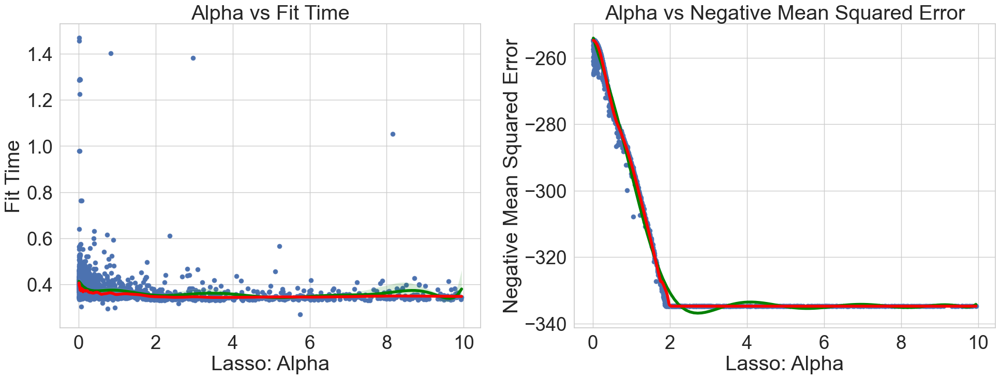

 - Gráfico de dispersión de Max Iter(Lasso) frente a Fit Time y neg MSE


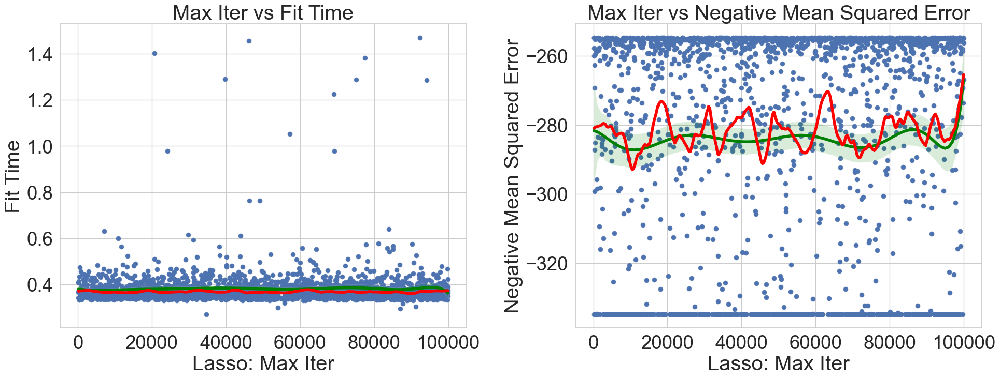

 - Gráfico de dispersión de Selection(Lasso) frente a Fit Time y neg MSE


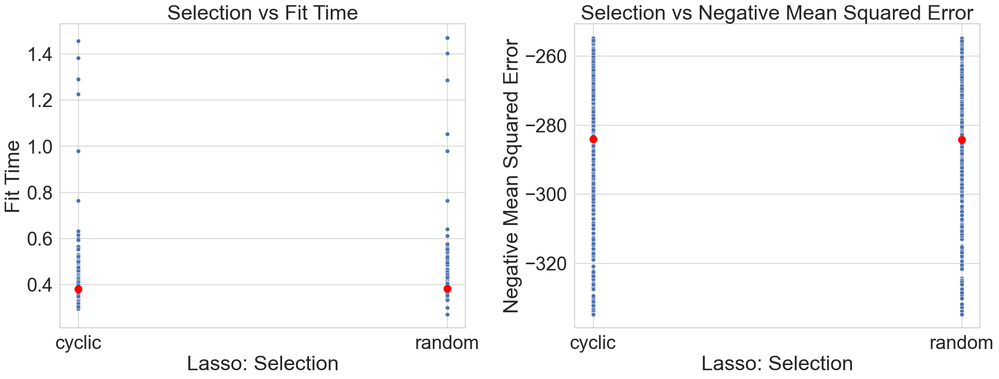

 - Gráfico de dispersión de Tol(Lasso) frente a Fit Time y neg MSE


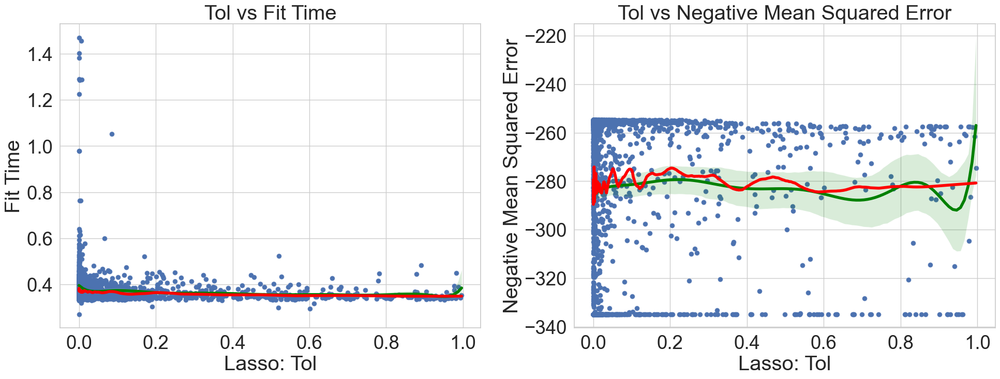

In [88]:
file_path = "analisis\_Lasso_df.csv"
algorithm = file_path.replace("analisis\\_", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, algorithm)
#plot_and_save_scatterplots_median(df, algorithm=algorithm, frac=0.03)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, lw=4)
#plot_and_save_scatterplots(df, algorithm=algorithm, comparison_column="neg_mean_squared_error")

(2000, 9)
 - Gráfico de dispersión de Alpha(Ridge) frente a Fit Time y neg MSE


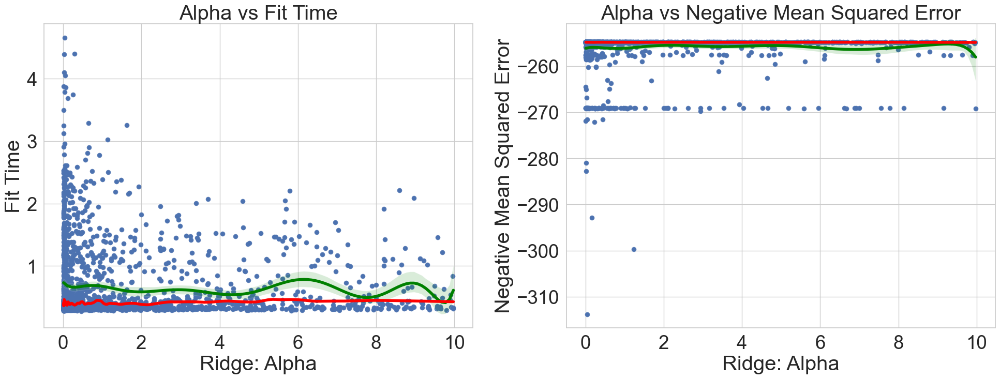

 - Gráfico de dispersión de Max Iter(Ridge) frente a Fit Time y neg MSE


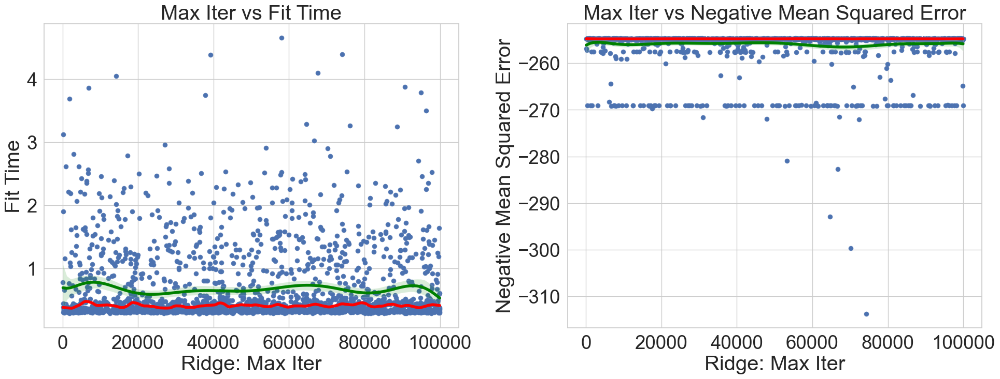

 - Gráfico de dispersión de Solver(Ridge) frente a Fit Time y neg MSE


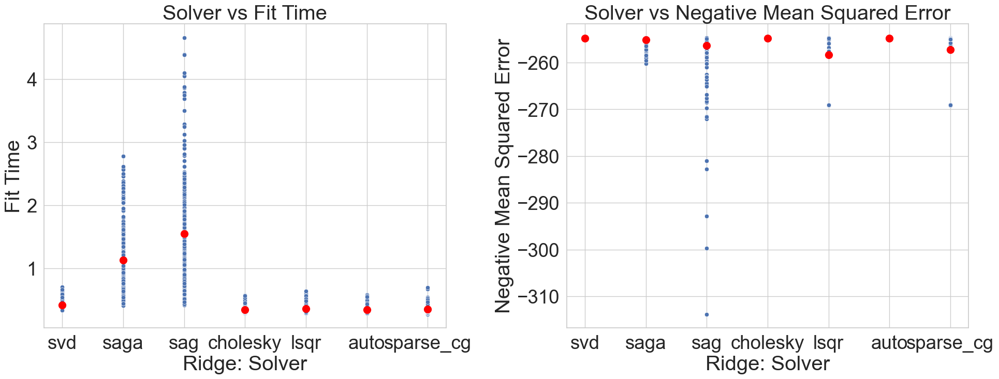

 - Gráfico de dispersión de Tol(Ridge) frente a Fit Time y neg MSE


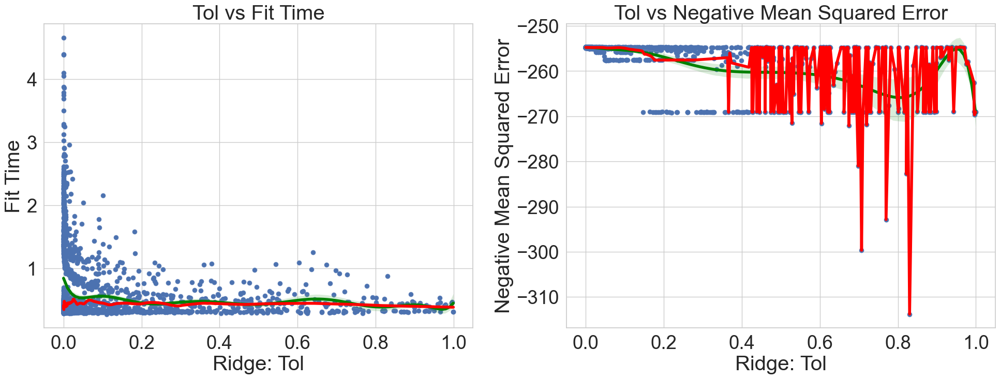

In [89]:
file_path = "analisis\_Ridge_df.csv"
algorithm = file_path.replace("analisis\\_", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, lw=4)
#plot_and_save_scatterplots(df, algorithm=algorithm, comparison_column="neg_mean_squared_error")

(2000, 10)
 - Gráfico de dispersión de Alpha(ElasticNet) frente a Fit Time y neg MSE


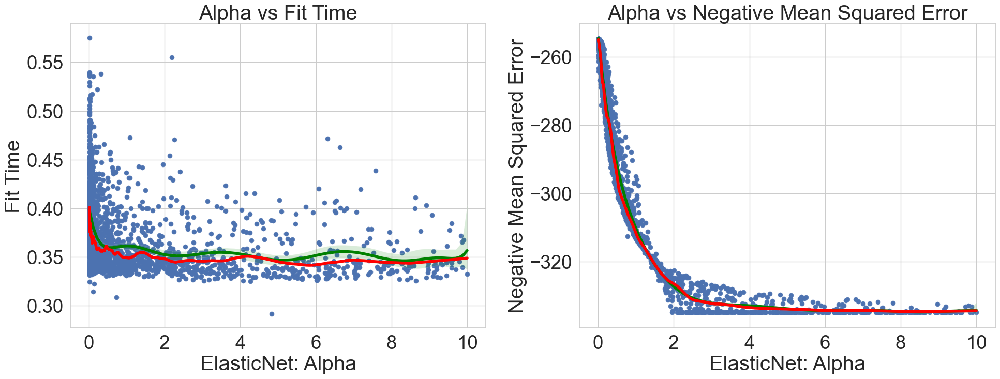

 - Gráfico de dispersión de L1 Ratio(ElasticNet) frente a Fit Time y neg MSE


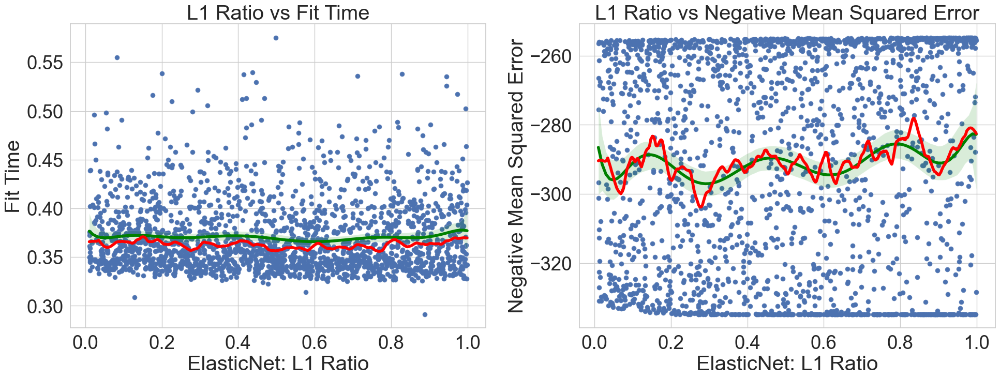

 - Gráfico de dispersión de Max Iter(ElasticNet) frente a Fit Time y neg MSE


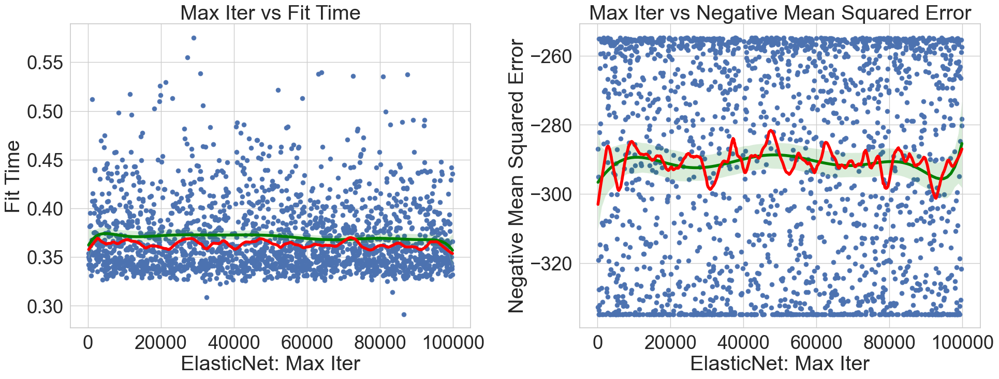

 - Gráfico de dispersión de Selection(ElasticNet) frente a Fit Time y neg MSE


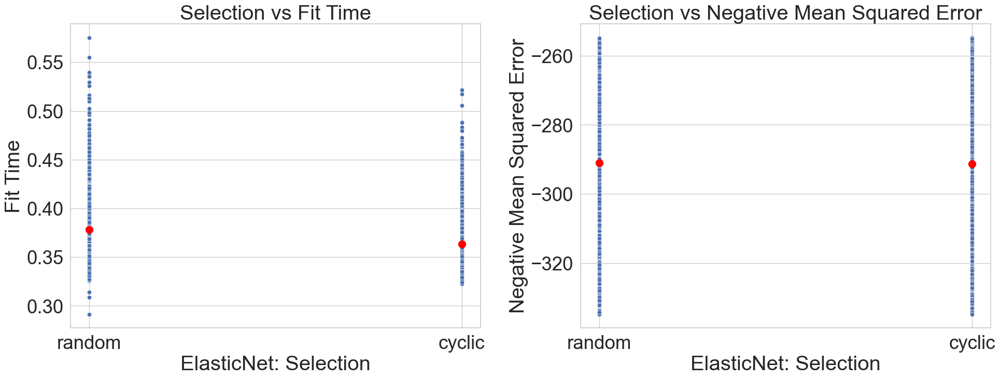

 - Gráfico de dispersión de Tol(ElasticNet) frente a Fit Time y neg MSE


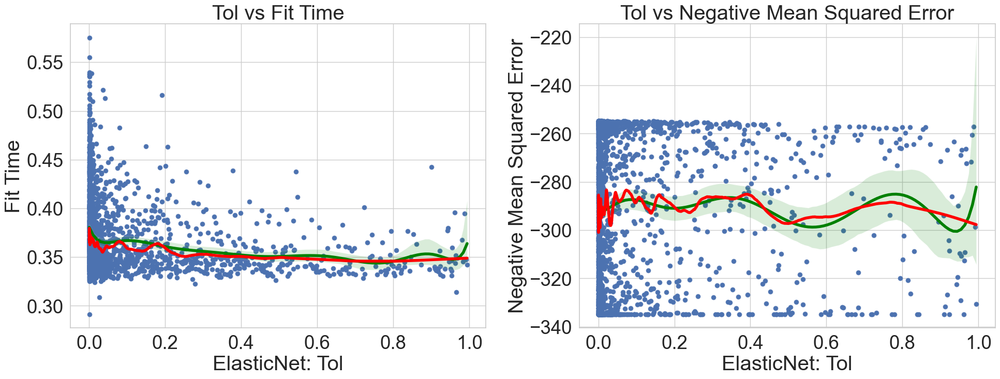

In [90]:
file_path = "analisis\_ElasticNet_df.csv"
algorithm = file_path.replace("analisis\\_", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10)
#plot_and_save_scatterplots(df, algorithm=algorithm, comparison_column="neg_mean_squared_error")

(500, 9)
 - Gráfico de dispersión de Learning Rate(GradientBoostingRegressor) frente a Fit Time y neg MSE


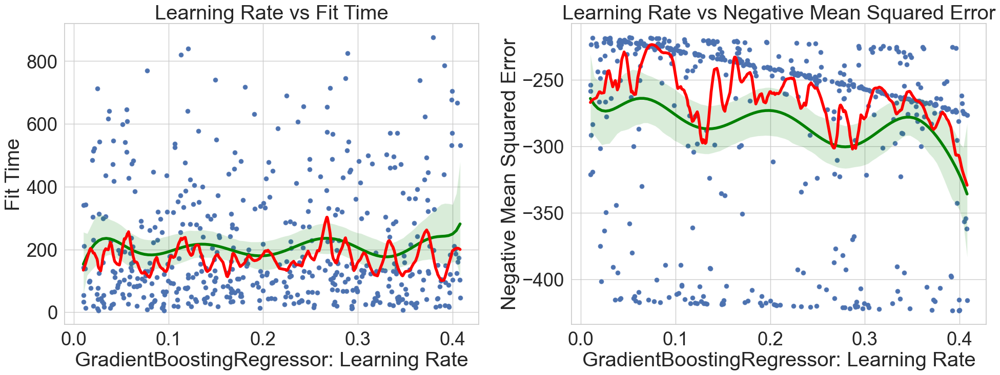

 - Gráfico de dispersión de Max Depth(GradientBoostingRegressor) frente a Fit Time y neg MSE


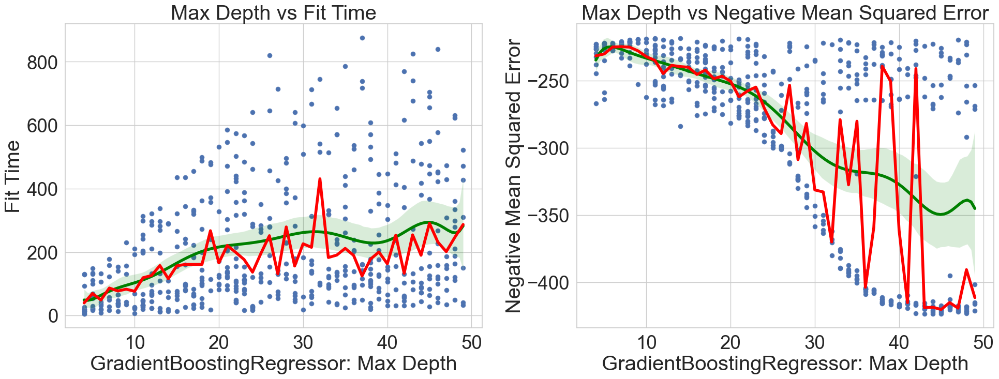

 - Gráfico de dispersión de Max Features(GradientBoostingRegressor) frente a Fit Time y neg MSE


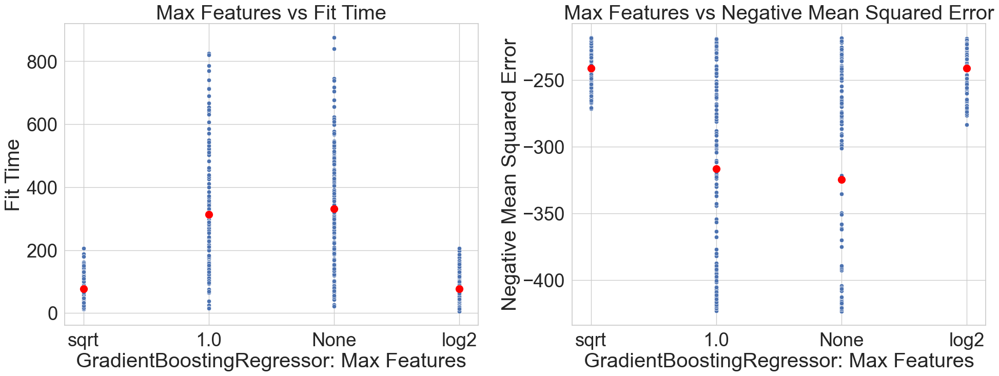

 - Gráfico de dispersión de N Estimators(GradientBoostingRegressor) frente a Fit Time y neg MSE


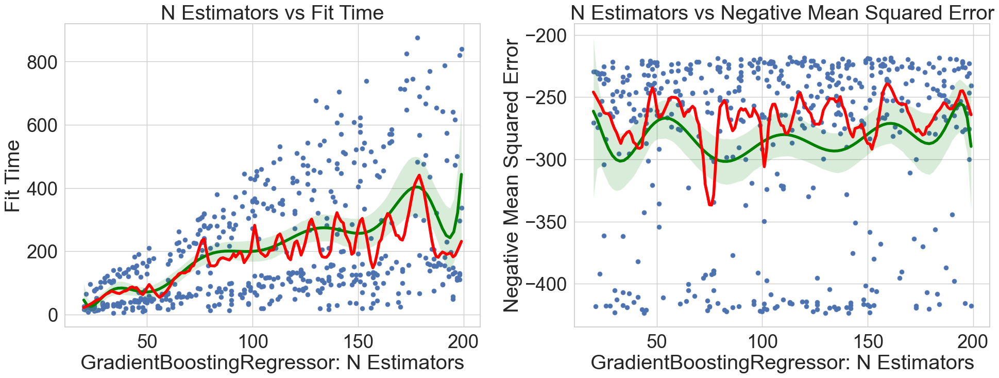

In [91]:
file_path = "analisis\_GradientBoostingRegressor_df.csv"
algorithm = file_path.replace("analisis\\_", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10)
#plot_and_save_scatterplots(df, algorithm=algorithm, comparison_column="neg_mean_squared_error")

(1750, 9)
 - Gráfico de dispersión de Learning Rate(HistGradientBoostingRegressor) frente a Fit Time y neg MSE


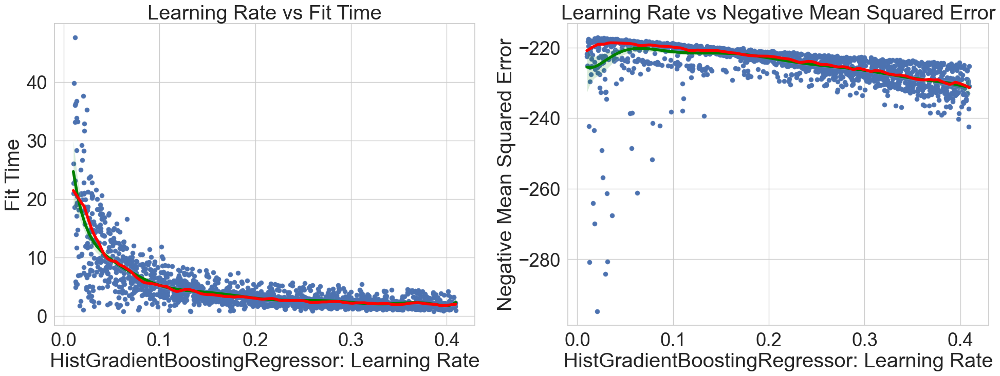

 - Gráfico de dispersión de Max Depth(HistGradientBoostingRegressor) frente a Fit Time y neg MSE


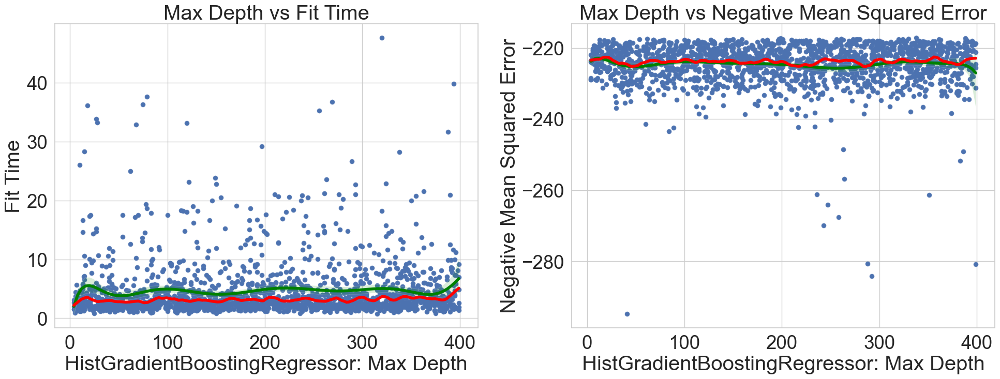

 - Gráfico de dispersión de Max Iter(HistGradientBoostingRegressor) frente a Fit Time y neg MSE


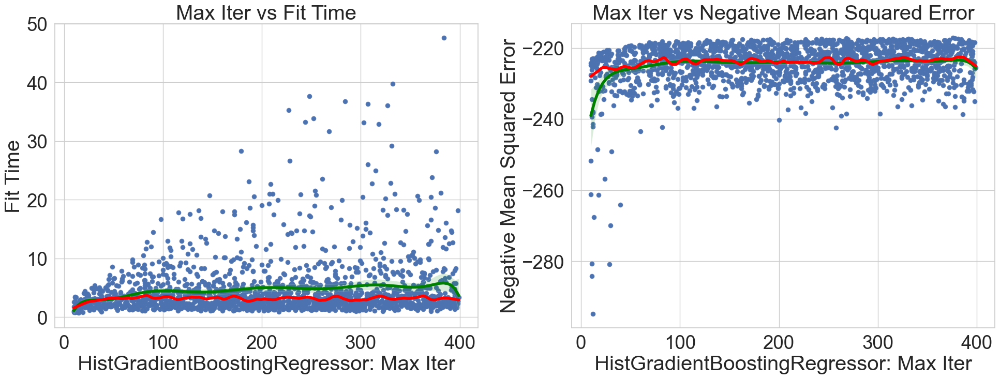

 - Gráfico de dispersión de Max Leaf Nodes(HistGradientBoostingRegressor) frente a Fit Time y neg MSE


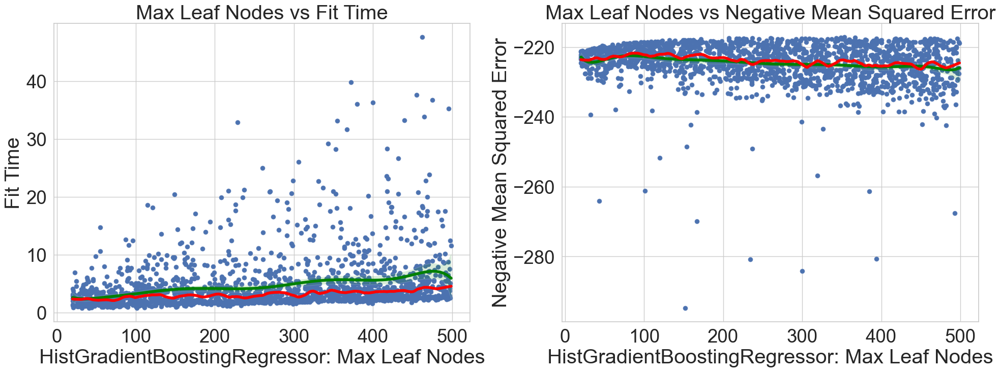

In [92]:
file_path = "analisis\_HistGradientBoostingRegressor_df.csv"
algorithm = file_path.replace("analisis\\_", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, lw = 4)

(333, 9)
 - Gráfico de dispersión de Learning Rate(LGBMRegressor) frente a Fit Time y neg MSE


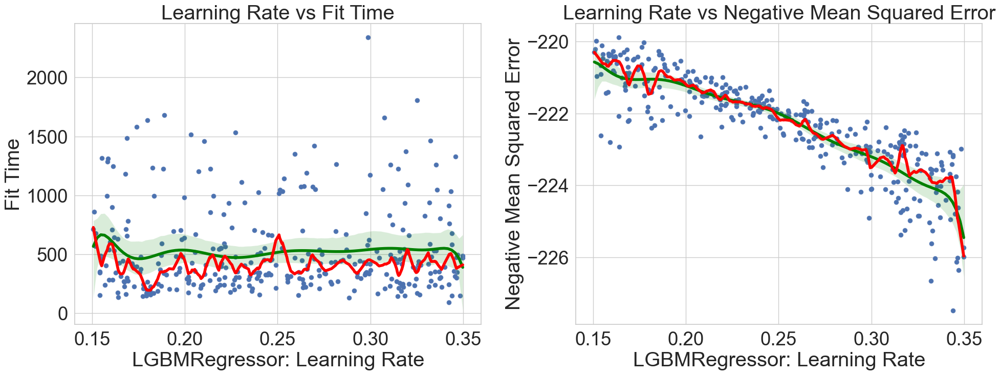

c:\Projects\TFG\winenv\Lib\site-packages\statsmodels\nonparametric\smoothers_lowess.py:226: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),
c:\Projects\TFG\winenv\Lib\site-packages\statsmodels\nonparametric\smoothers_lowess.py:226: RuntimeWarning: invalid value encountered in divide
  res, _ = _lowess(y, x, x, np.ones_like(x),


 - Gráfico de dispersión de Max Depth(LGBMRegressor) frente a Fit Time y neg MSE


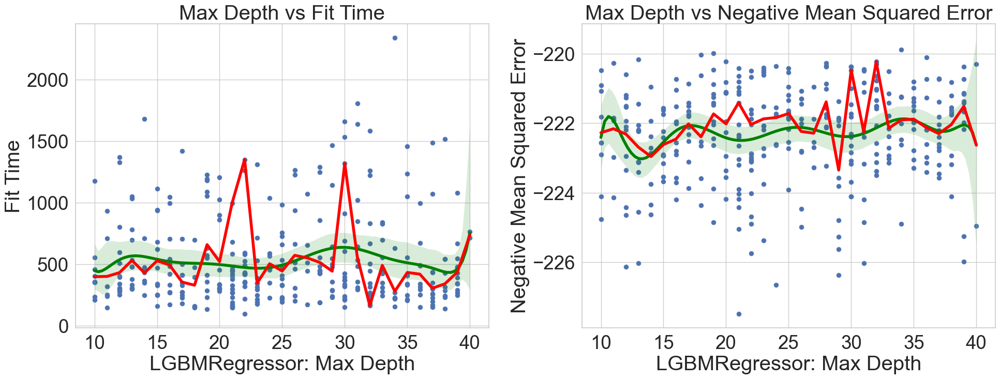

 - Gráfico de dispersión de N Estimators(LGBMRegressor) frente a Fit Time y neg MSE


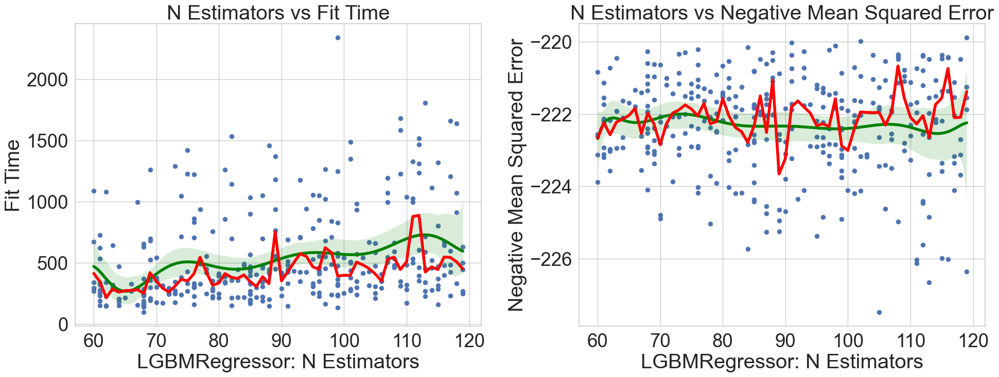

 - Gráfico de dispersión de Num Leaves(LGBMRegressor) frente a Fit Time y neg MSE


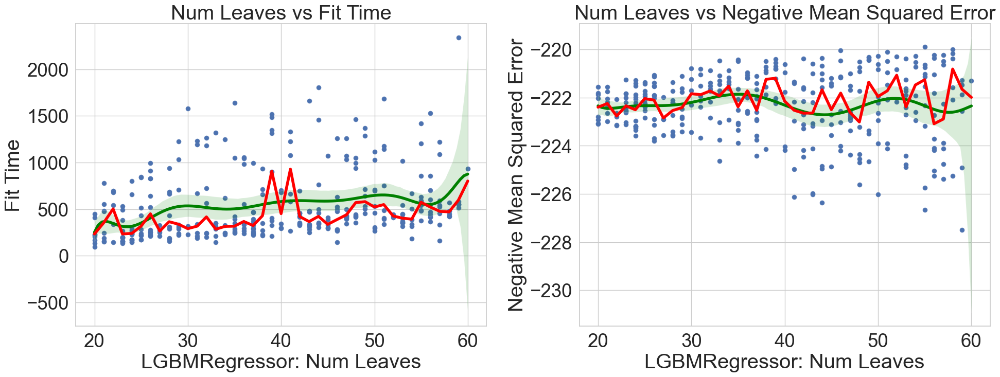

In [93]:
file_path = "analisis\_LGBMRegressor_df.csv"
algorithm = file_path.replace("analisis\\_", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
df = df[df['num_leaves'] <= 60]
df = df[df['max_depth'] <= 40]
df = df[df['n_estimators'] <= 120]
print(df.shape)
df_to_word(df, algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10)

(500, 8)
 - Gráfico de dispersión de Learning Rate(XGBRegressor) frente a Fit Time y neg MSE


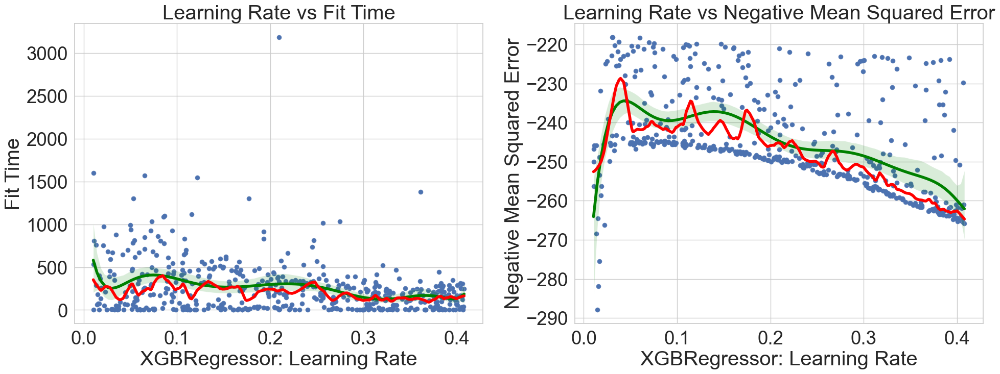

 - Gráfico de dispersión de Max Depth(XGBRegressor) frente a Fit Time y neg MSE


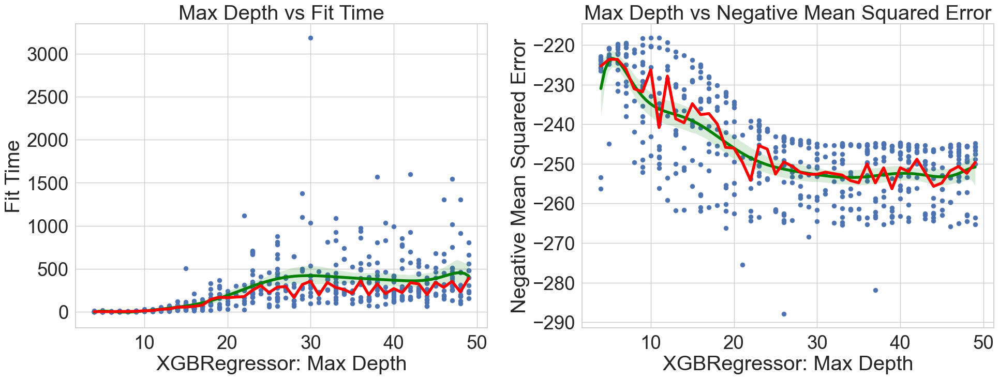

 - Gráfico de dispersión de N Estimators(XGBRegressor) frente a Fit Time y neg MSE


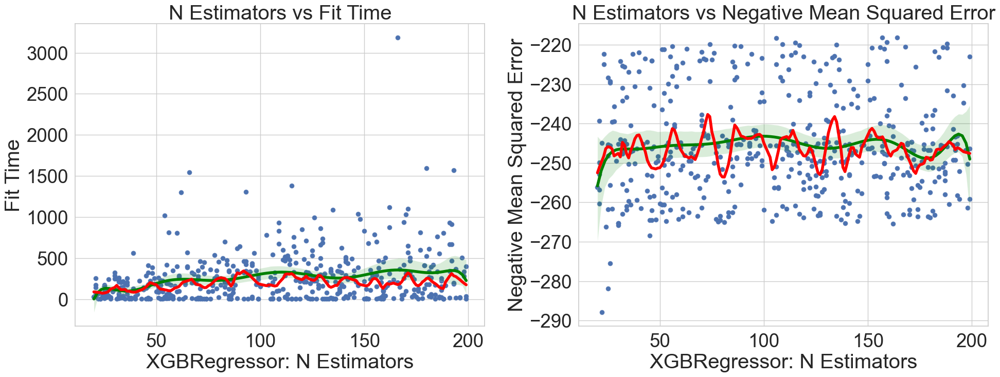

In [94]:
file_path = "analisis\_XGBRegressor_df.csv"
algorithm = file_path.replace("analisis\\_", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10)

(496, 8)
 - Gráfico de dispersión de Max Depth(RandomForestRegressor) frente a Fit Time y neg MSE


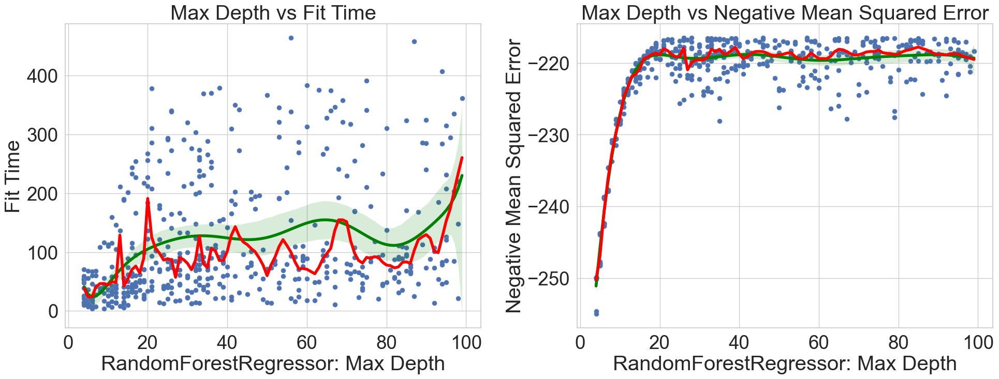

 - Gráfico de dispersión de Max Features(RandomForestRegressor) frente a Fit Time y neg MSE


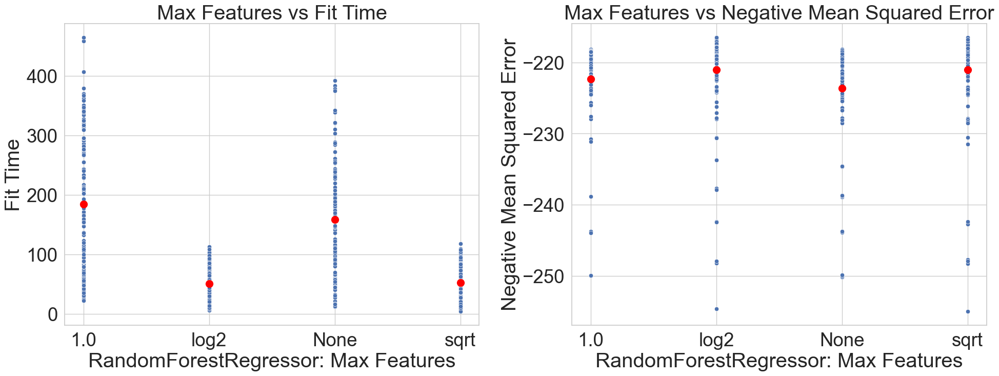

 - Gráfico de dispersión de N Estimators(RandomForestRegressor) frente a Fit Time y neg MSE


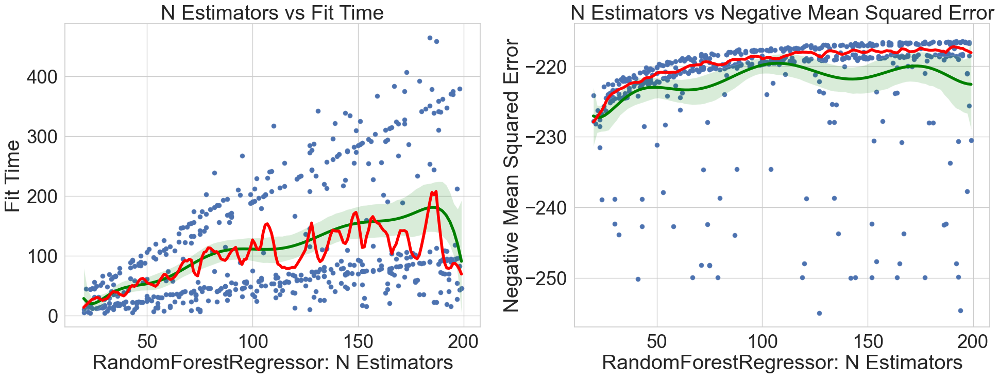

In [95]:
file_path = "analisis\_RandomForestRegressor_df.csv"
algorithm = file_path.replace("analisis\\_", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10)

(702, 10)
 - Gráfico de dispersión de Algorithm(KNeighborsRegressor) frente a Fit Time y neg MSE


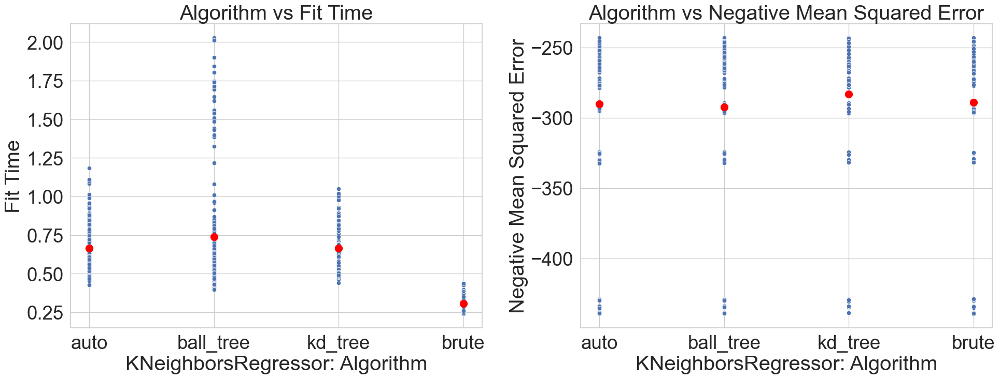

 - Gráfico de dispersión de Leaf Size(KNeighborsRegressor) frente a Fit Time y neg MSE


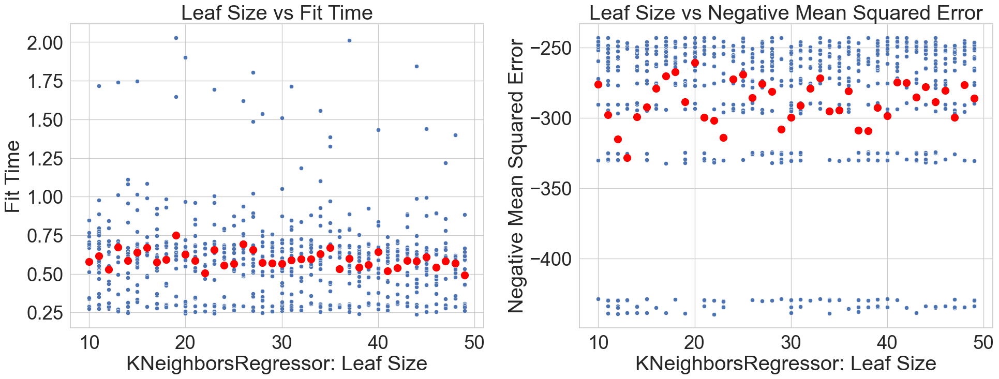

 - Gráfico de dispersión de N Neighbors(KNeighborsRegressor) frente a Fit Time y neg MSE


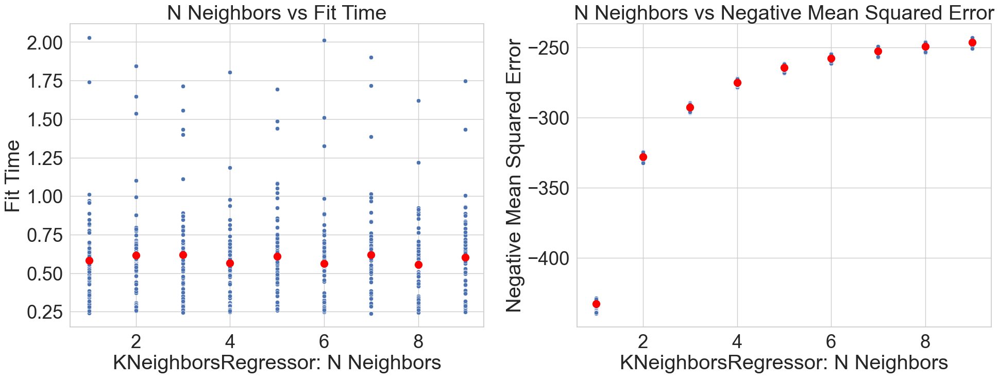

 - Gráfico de dispersión de P(KNeighborsRegressor) frente a Fit Time y neg MSE


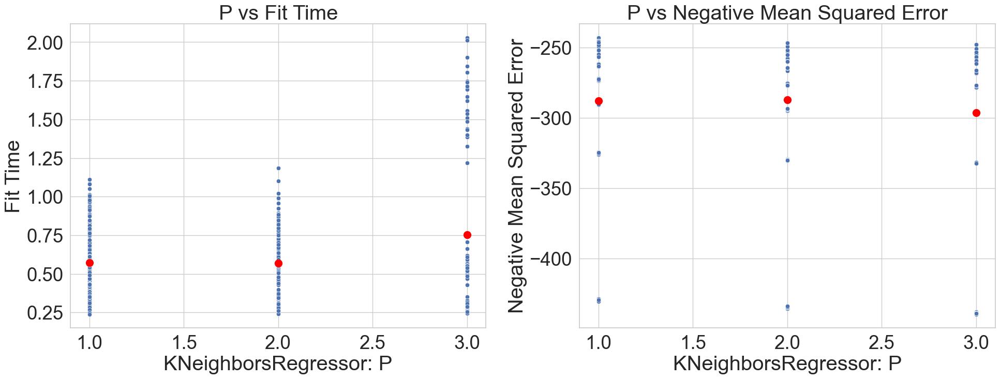

 - Gráfico de dispersión de Weights(KNeighborsRegressor) frente a Fit Time y neg MSE


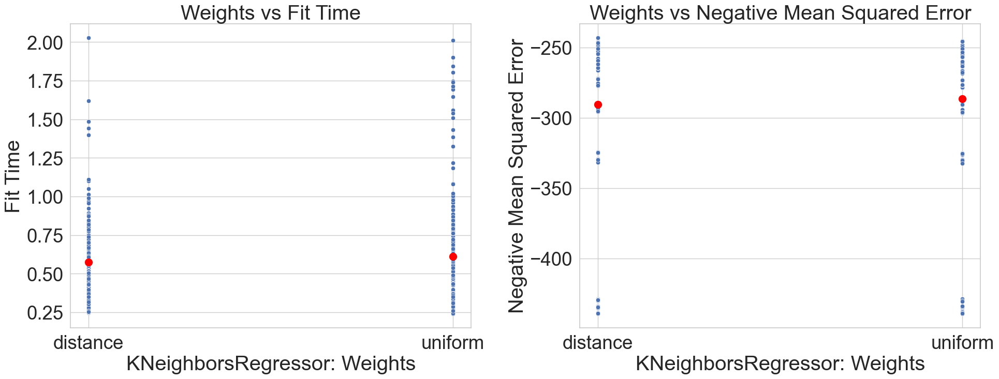

In [96]:
file_path = "analisis\_KNeighborsRegressor_df.csv"
algorithm = file_path.replace("analisis\\_", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, only_median_plots=True)

(800, 9)
 - Gráfico de dispersión de C(LinearSVR) frente a Fit Time y neg MSE


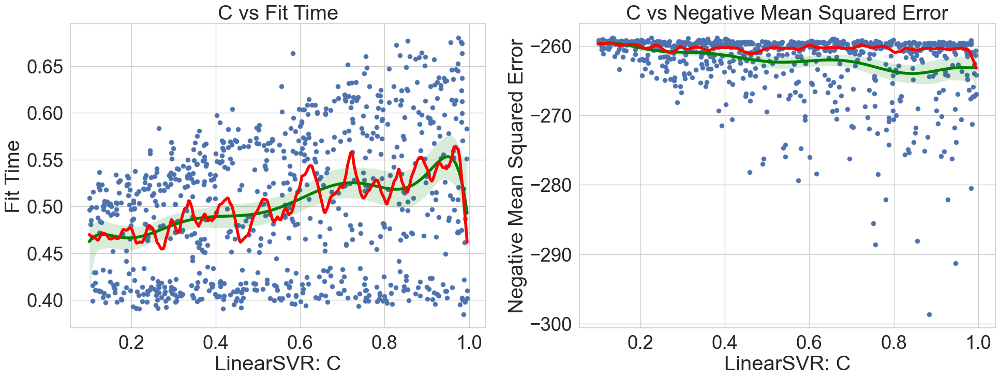

 - Gráfico de dispersión de Dual(LinearSVR) frente a Fit Time y neg MSE


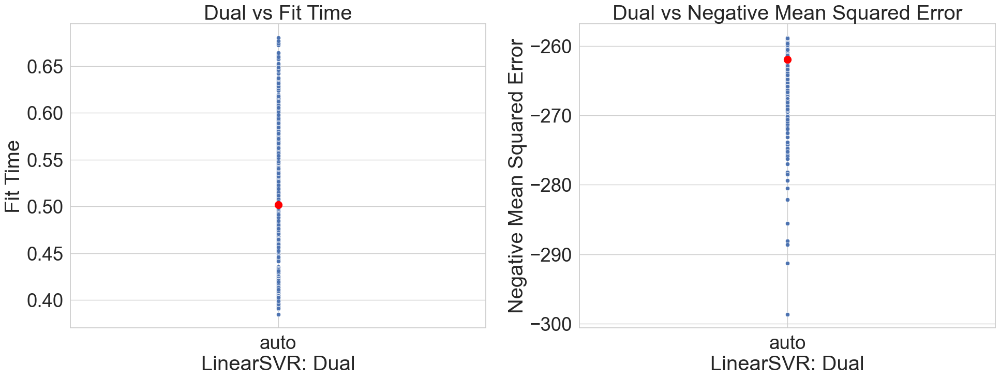

 - Gráfico de dispersión de Max Iter(LinearSVR) frente a Fit Time y neg MSE


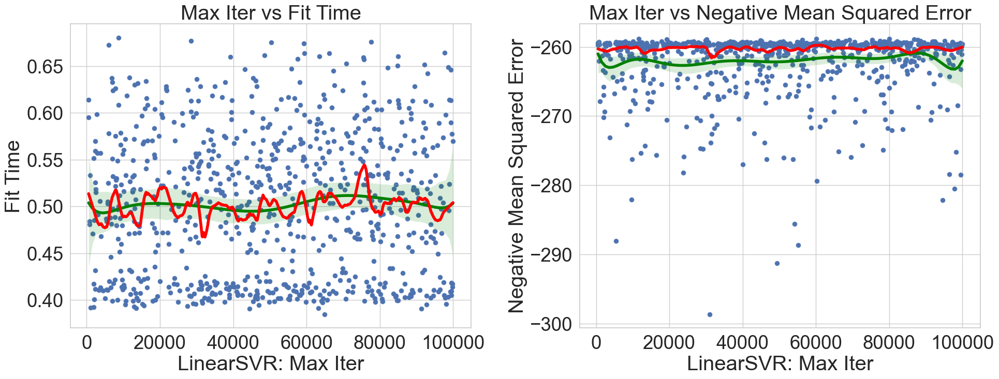

 - Gráfico de dispersión de Tol(LinearSVR) frente a Fit Time y neg MSE


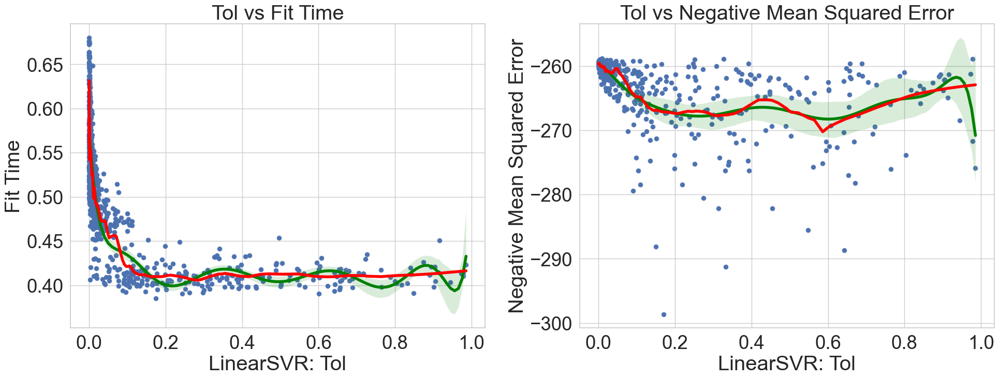

In [97]:
file_path = "analisis\_LinearSVR_df.csv"
algorithm = file_path.replace("analisis\\_", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10)

ALGORITMOS DE CLASIFICACIÓN

N_BINS = 5; UNIFORM

(648, 10)
 - Gráfico de dispersión de Class Weight(RandomForestClassifier) frente a Fit Time y Balanced Accuracy


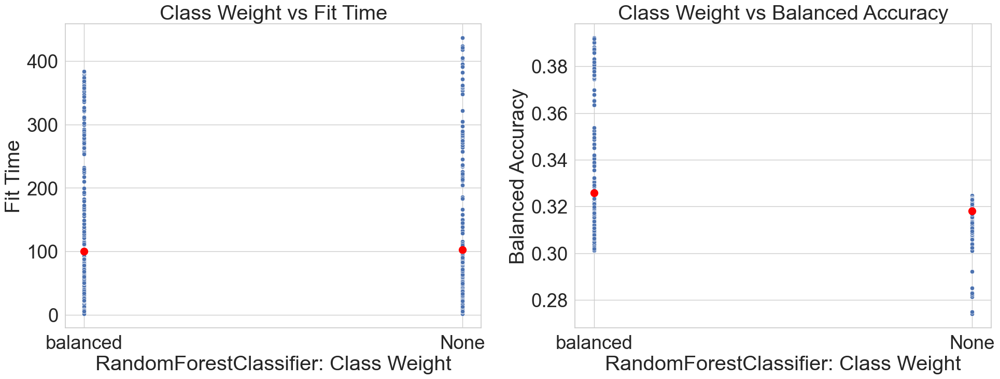

 - Gráfico de dispersión de Max Depth(RandomForestClassifier) frente a Fit Time y Balanced Accuracy


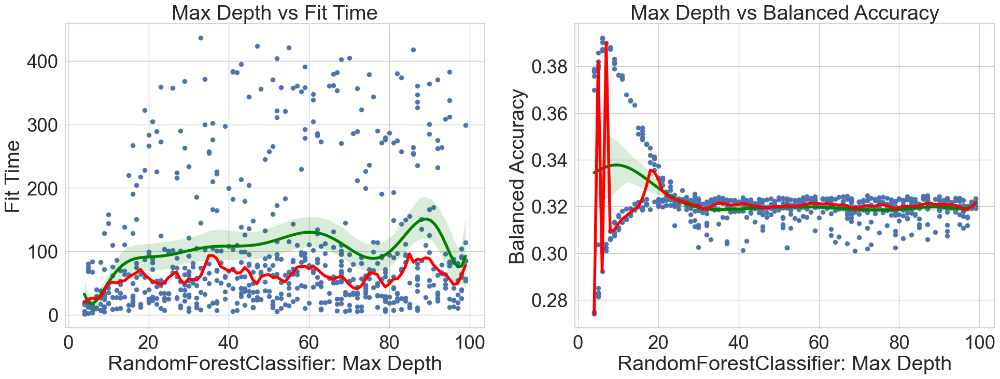

 - Gráfico de dispersión de Max Features(RandomForestClassifier) frente a Fit Time y Balanced Accuracy


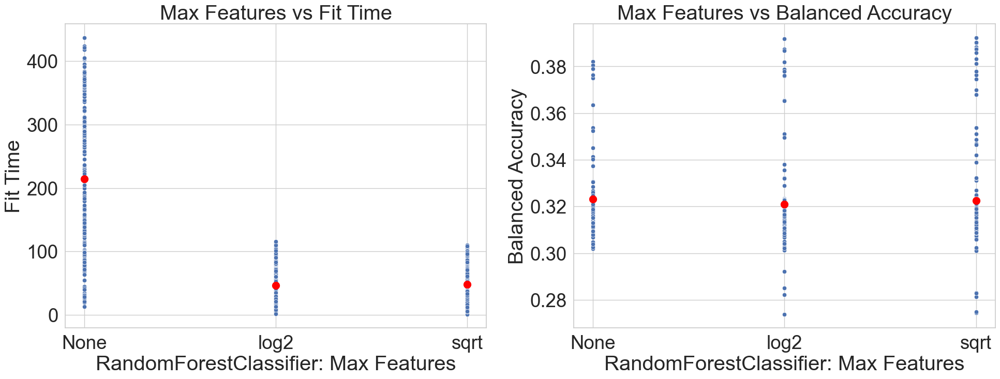

 - Gráfico de dispersión de N Estimators(RandomForestClassifier) frente a Fit Time y Balanced Accuracy


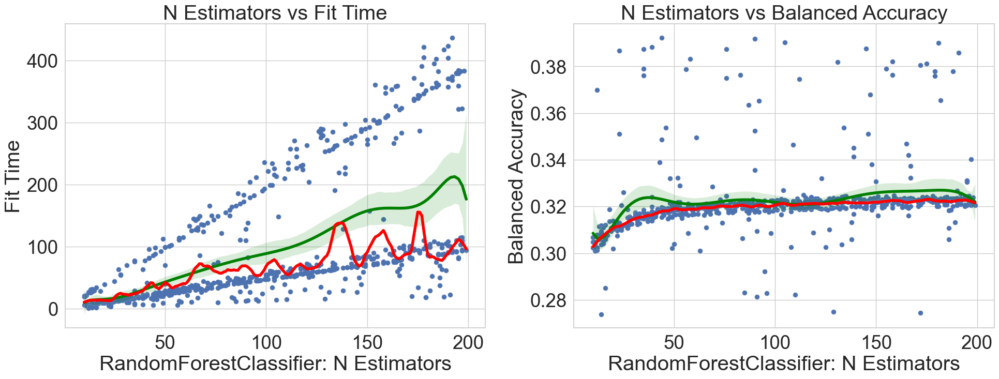

In [99]:
file_path = "analisis\\n_bins-5_uniform__RandomForestClassifier_df.csv"
algorithm = file_path.replace("analisis\\n_bins-5_uniform__", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, f'5-bins_{algorithm}', orderer_by="balanced_accuracy")
#plot_and_save_scatterplots_median(df, algorithm=algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, regression=False)

(400, 11)
 - Gráfico de dispersión de Grow Policy(XGBClassifier) frente a Fit Time y Balanced Accuracy


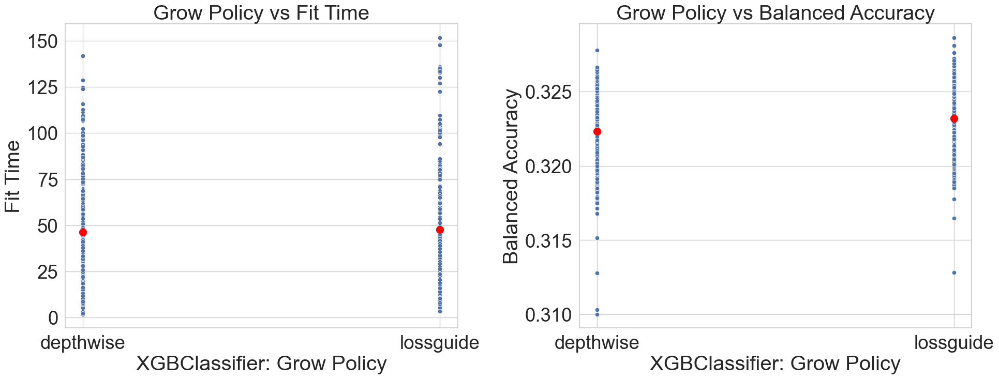

 - Gráfico de dispersión de Learning Rate(XGBClassifier) frente a Fit Time y Balanced Accuracy


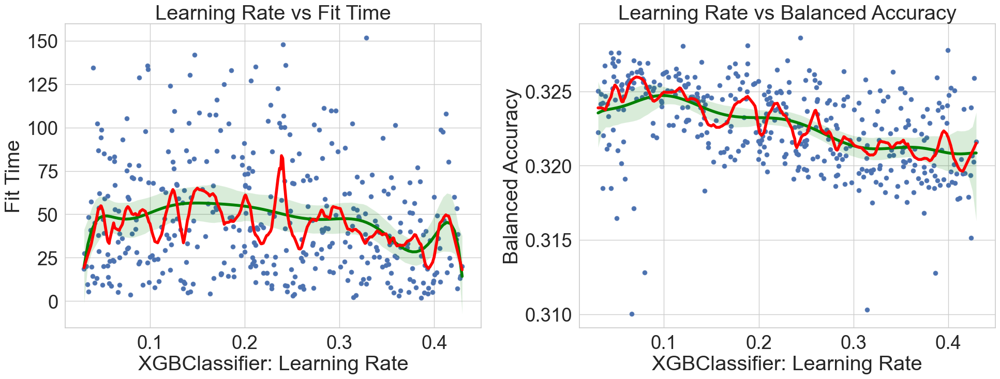

 - Gráfico de dispersión de Max Depth(XGBClassifier) frente a Fit Time y Balanced Accuracy


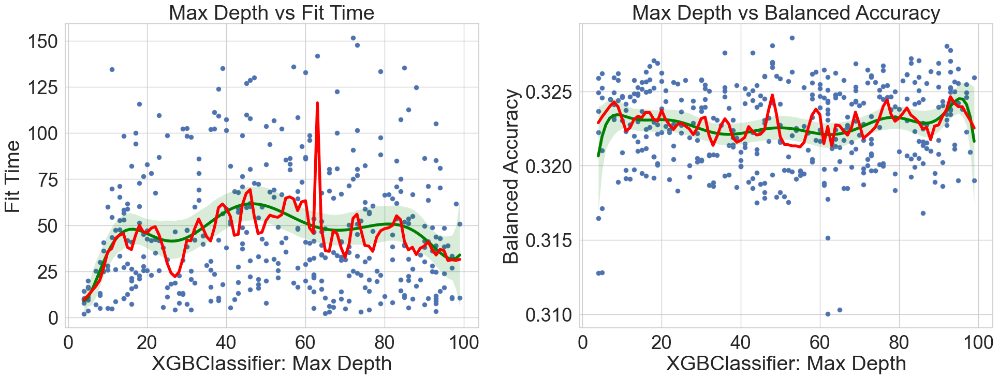

 - Gráfico de dispersión de Max Leaves(XGBClassifier) frente a Fit Time y Balanced Accuracy


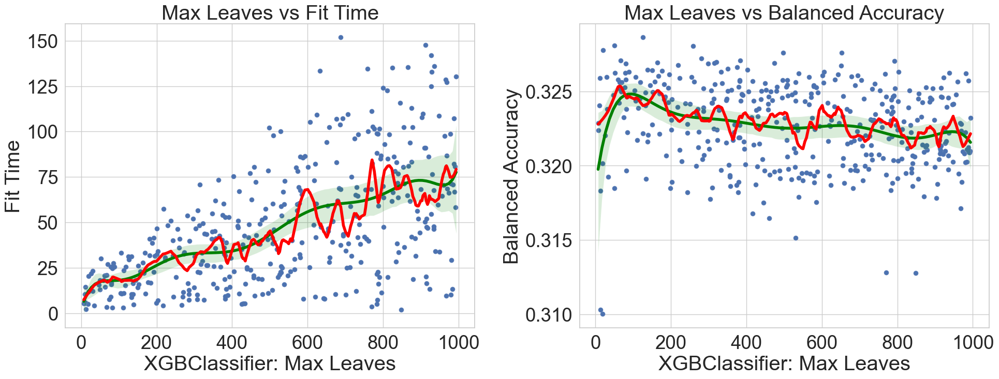

 - Gráfico de dispersión de N Estimators(XGBClassifier) frente a Fit Time y Balanced Accuracy


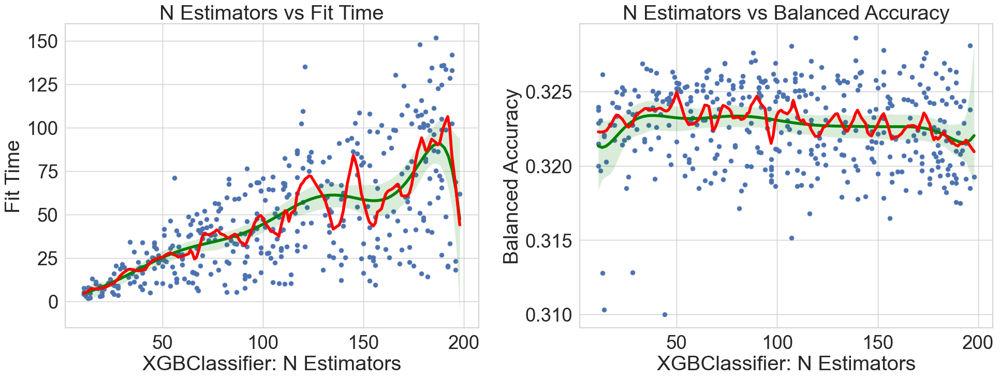

In [55]:
file_path = "analisis\\n_bins-5_uniform__XGBClassifier_df.csv"
algorithm = file_path.replace("analisis\\n_bins-5_uniform__", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, f'5-bins_{algorithm}', orderer_by="balanced_accuracy")
#plot_and_save_scatterplots_median(df, algorithm=algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, regression=False)

(700, 11)
 - Gráfico de dispersión de Class Weight(HistGradientBoostingClassifier) frente a Fit Time y Balanced Accuracy


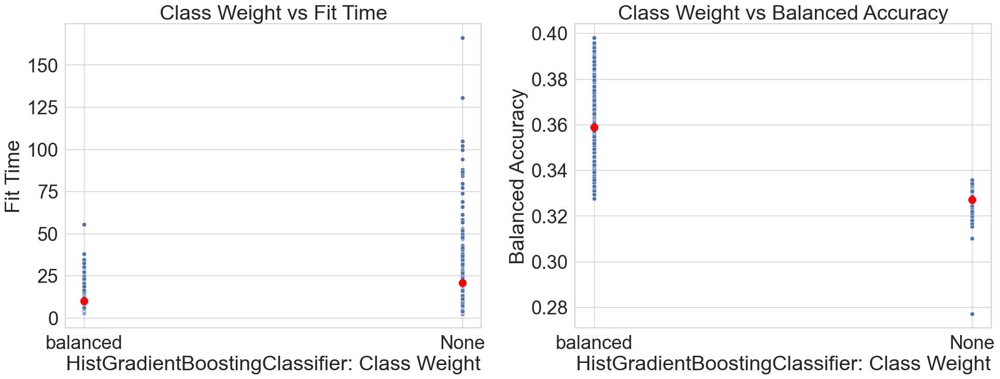

 - Gráfico de dispersión de Learning Rate(HistGradientBoostingClassifier) frente a Fit Time y Balanced Accuracy


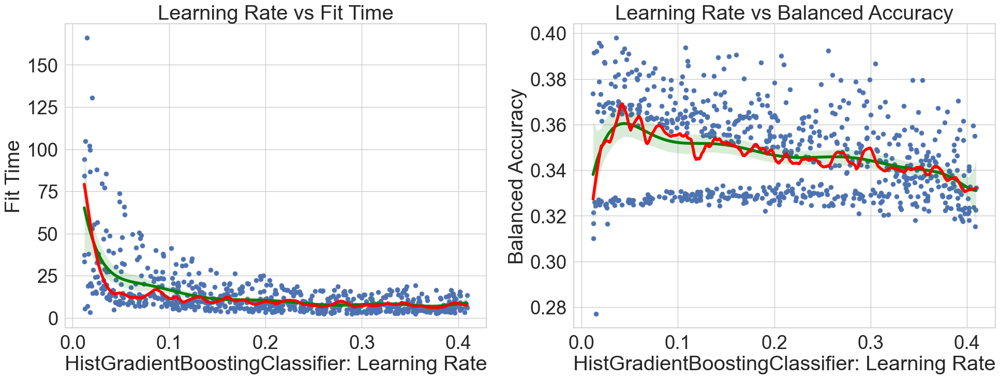

 - Gráfico de dispersión de Max Depth(HistGradientBoostingClassifier) frente a Fit Time y Balanced Accuracy


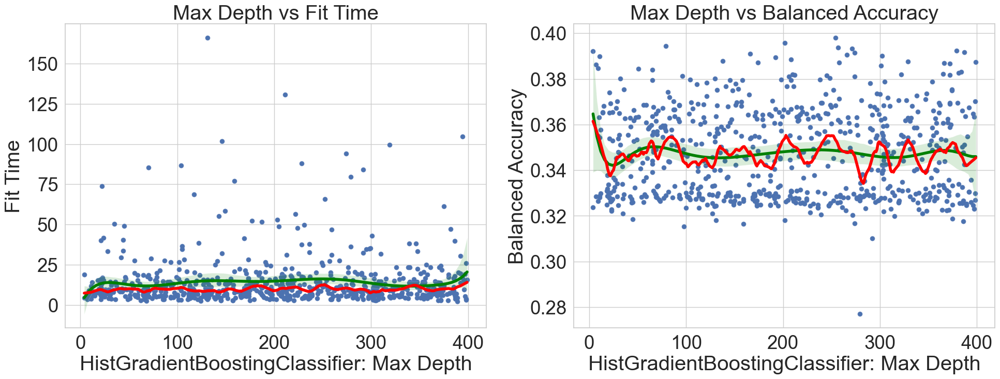

 - Gráfico de dispersión de Max Iter(HistGradientBoostingClassifier) frente a Fit Time y Balanced Accuracy


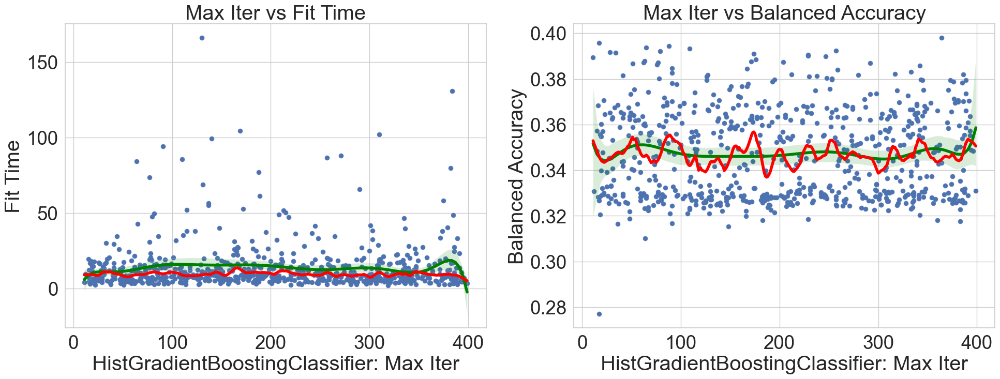

 - Gráfico de dispersión de Max Leaf Nodes(HistGradientBoostingClassifier) frente a Fit Time y Balanced Accuracy


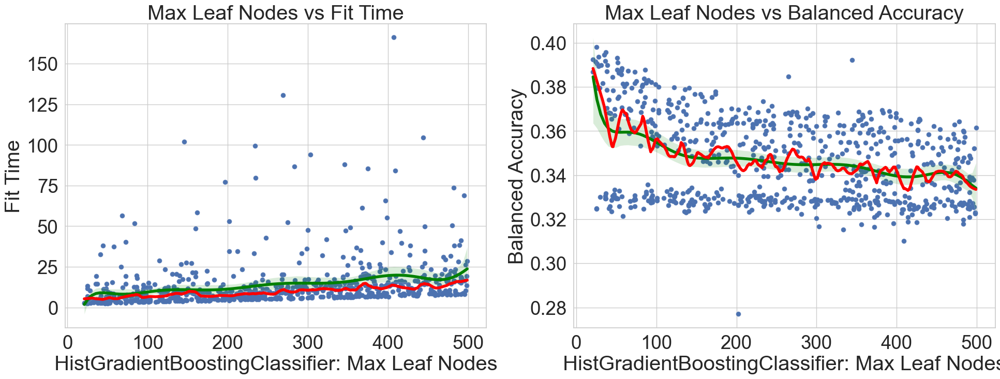

In [56]:
file_path = "analisis\\n_bins-5_uniform__HistGradientBoostingClassifier_df.csv"
algorithm = file_path.replace("analisis\\n_bins-5_uniform__", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, f'5-bins_{algorithm}', orderer_by="balanced_accuracy")
#plot_and_save_scatterplots_median(df, algorithm=algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, regression=False)

(532, 10)
 - Gráfico de dispersión de Class Weight(DecisionTreeClassifier) frente a Fit Time y Balanced Accuracy


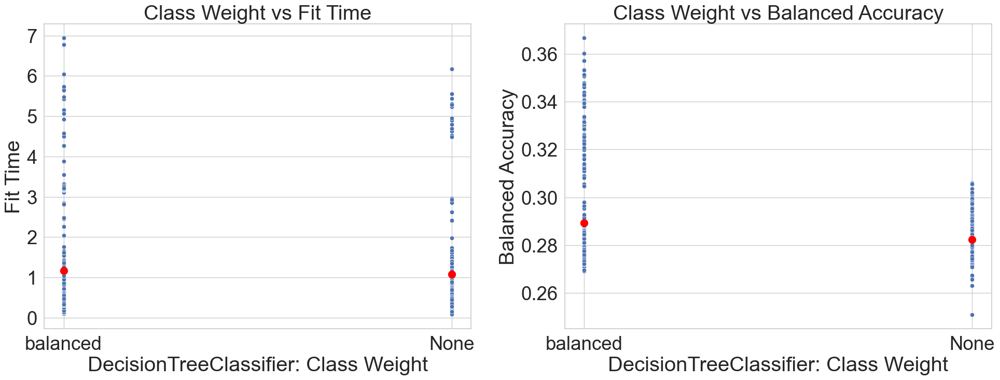

 - Gráfico de dispersión de Max Depth(DecisionTreeClassifier) frente a Fit Time y Balanced Accuracy


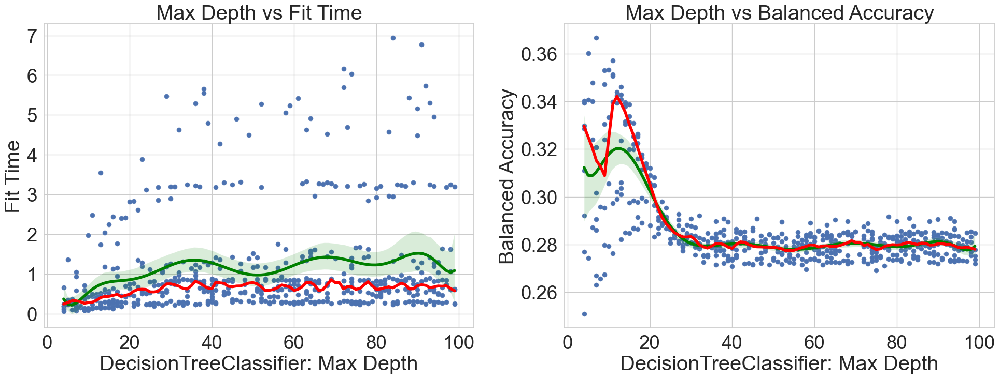

 - Gráfico de dispersión de Max Features(DecisionTreeClassifier) frente a Fit Time y Balanced Accuracy


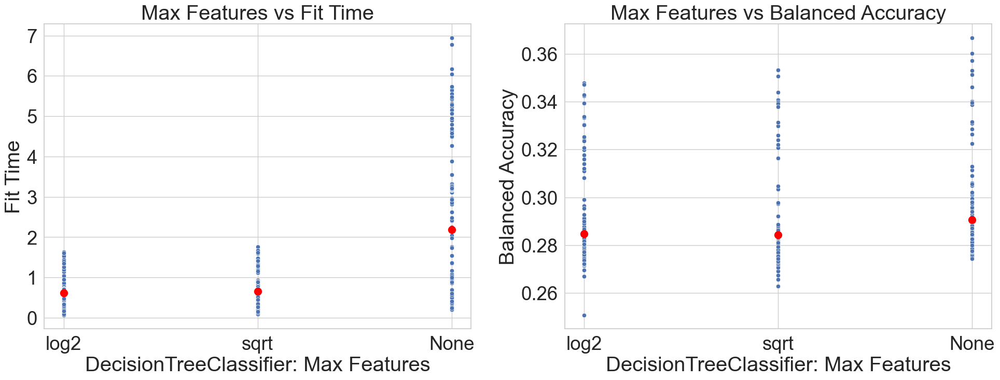

 - Gráfico de dispersión de Splitter(DecisionTreeClassifier) frente a Fit Time y Balanced Accuracy


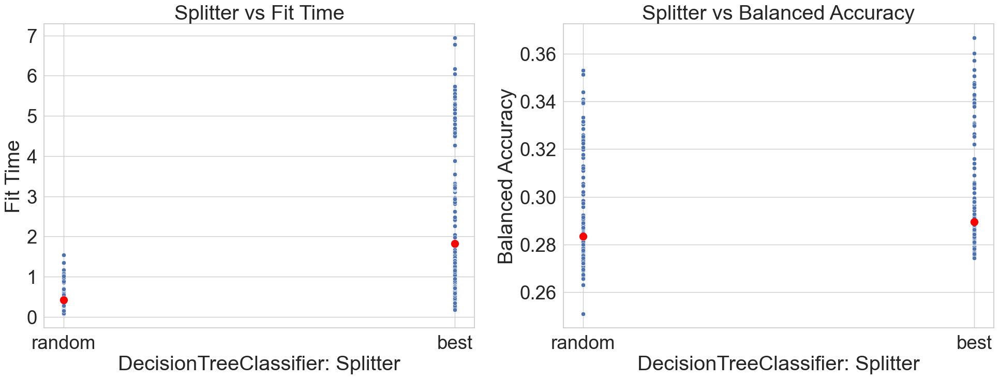

In [57]:
file_path = "analisis\\n_bins-5_uniform__DecisionTreeClassifier_df.csv"
algorithm = file_path.replace("analisis\\n_bins-5_uniform__", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, f'5-bins_{algorithm}', orderer_by="balanced_accuracy")
#plot_and_save_scatterplots_median(df, algorithm=algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, regression=False)

(700, 10)
 - Gráfico de dispersión de C(LinearSVC) frente a Fit Time y Balanced Accuracy


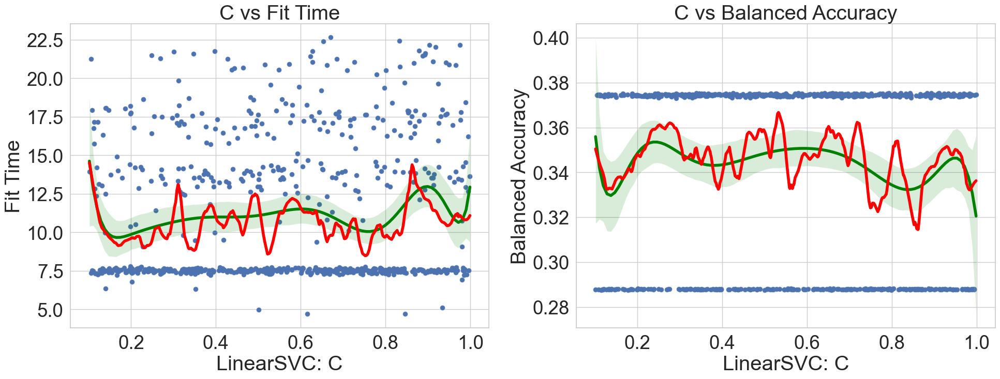

 - Gráfico de dispersión de Class Weight(LinearSVC) frente a Fit Time y Balanced Accuracy


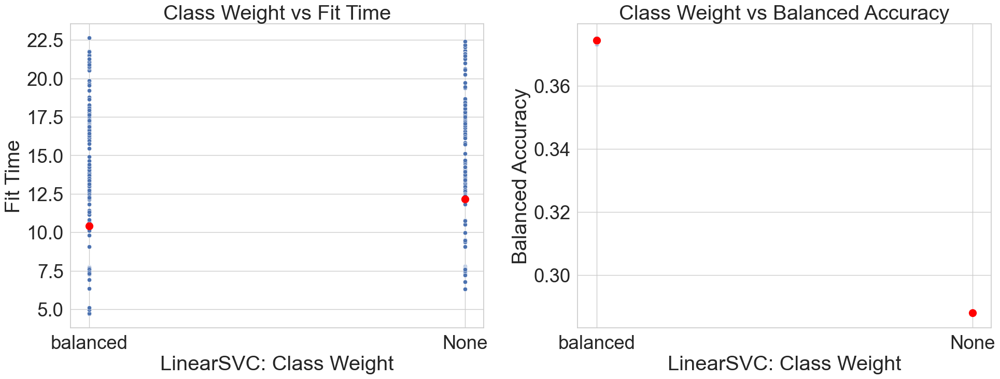

 - Gráfico de dispersión de Dual(LinearSVC) frente a Fit Time y Balanced Accuracy


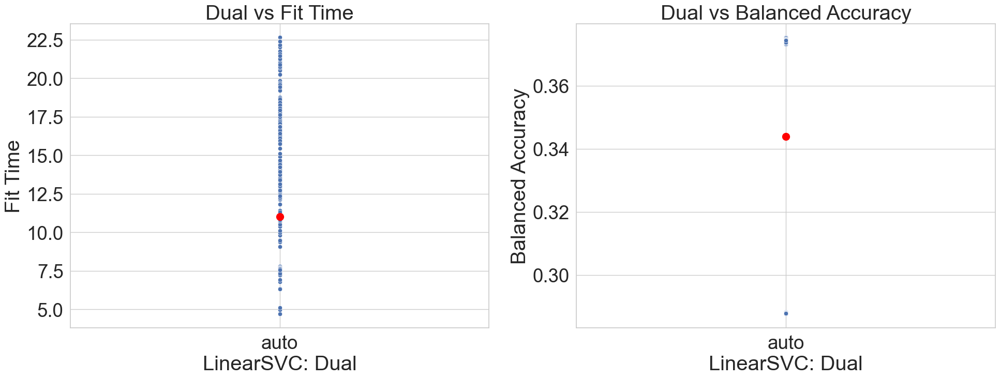

 - Gráfico de dispersión de Max Iter(LinearSVC) frente a Fit Time y Balanced Accuracy


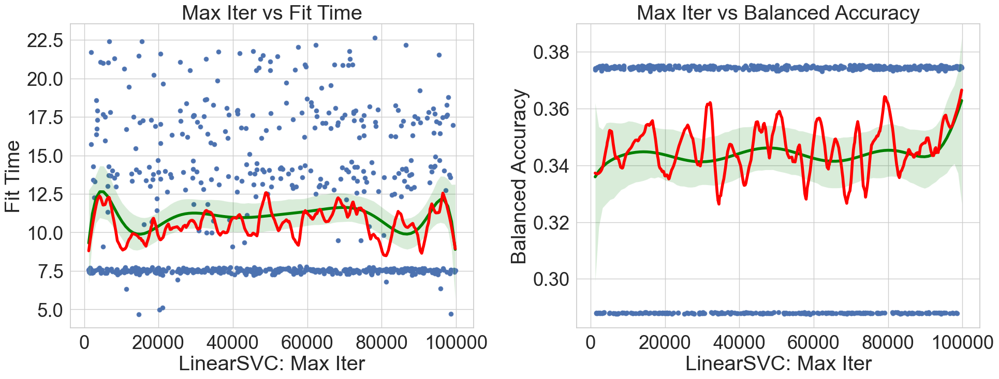

In [58]:
file_path = "analisis\\n_bins-5_uniform__LinearSVC_df.csv"
algorithm = file_path.replace("analisis\\n_bins-5_uniform__", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, f'5-bins_{algorithm}', orderer_by="balanced_accuracy")
#plot_and_save_scatterplots_median(df, algorithm=algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, regression=False)

10 SPLITS - UNIFORM

(499, 10)
 - Gráfico de dispersión de Class Weight(RandomForestClassifier) frente a Fit Time y Balanced Accuracy


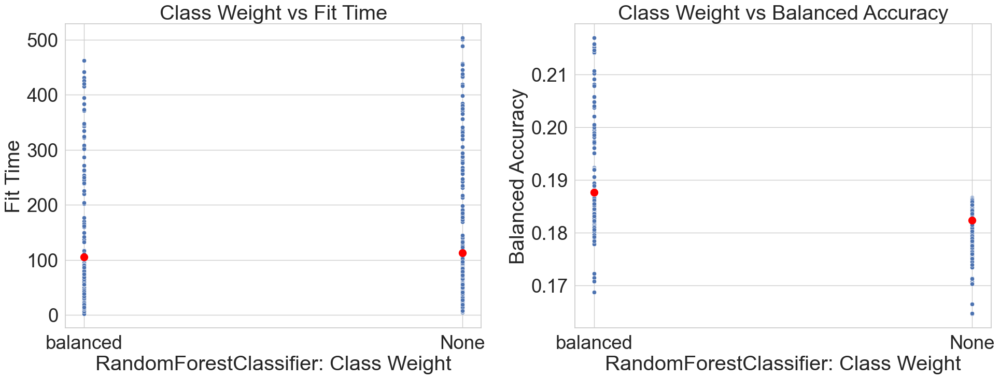

 - Gráfico de dispersión de Max Depth(RandomForestClassifier) frente a Fit Time y Balanced Accuracy


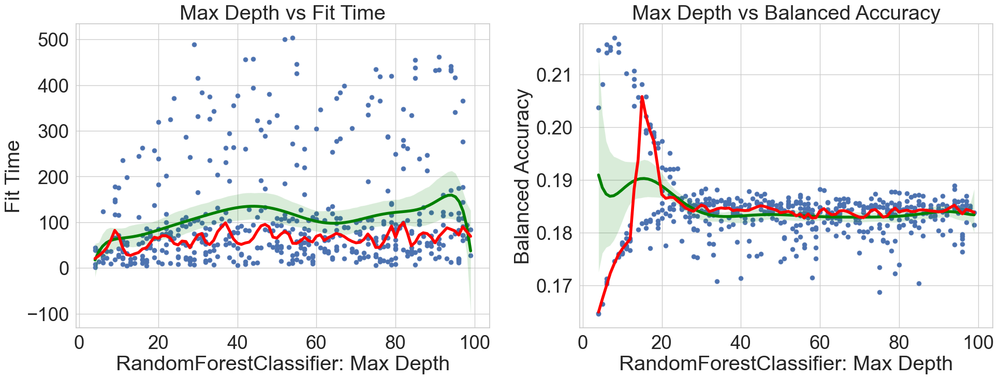

 - Gráfico de dispersión de Max Features(RandomForestClassifier) frente a Fit Time y Balanced Accuracy


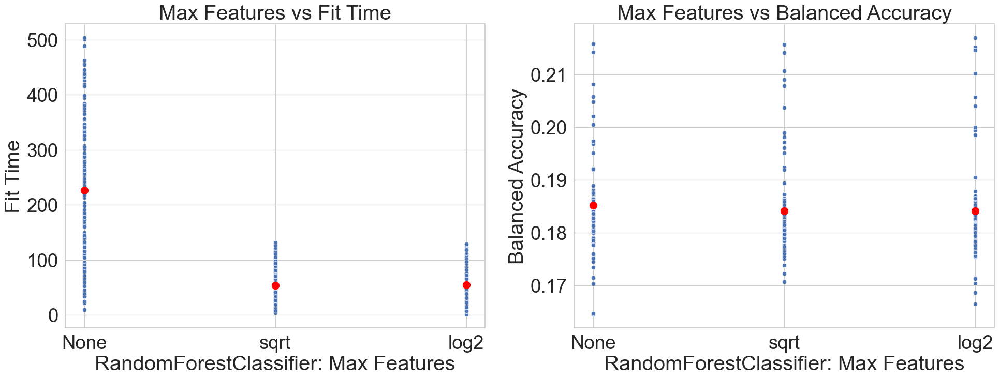

 - Gráfico de dispersión de N Estimators(RandomForestClassifier) frente a Fit Time y Balanced Accuracy


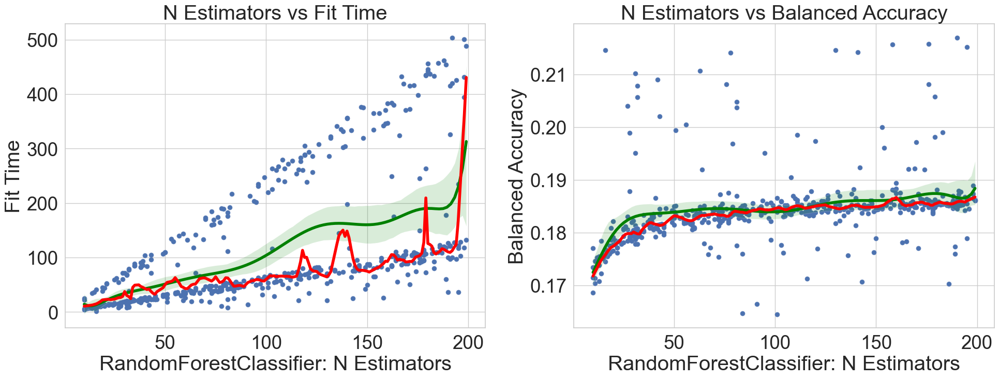

In [62]:
file_path = "analisis\\n_bins-10_uniform__RandomForestClassifier_df.csv"
algorithm = file_path.replace("analisis\\n_bins-10_uniform__", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, f'10-bins_{algorithm}', orderer_by="balanced_accuracy")
#plot_and_save_scatterplots_median(df, algorithm=algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, regression=False)

(346, 11)
 - Gráfico de dispersión de Grow Policy(XGBClassifier) frente a Fit Time y Balanced Accuracy


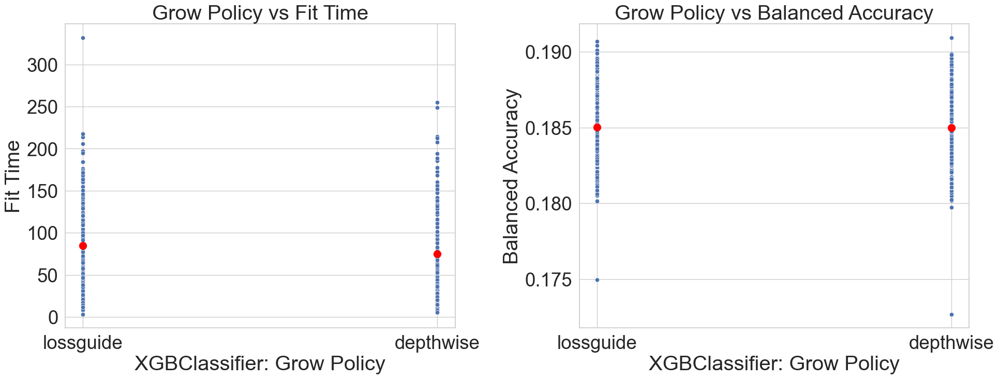

 - Gráfico de dispersión de Learning Rate(XGBClassifier) frente a Fit Time y Balanced Accuracy


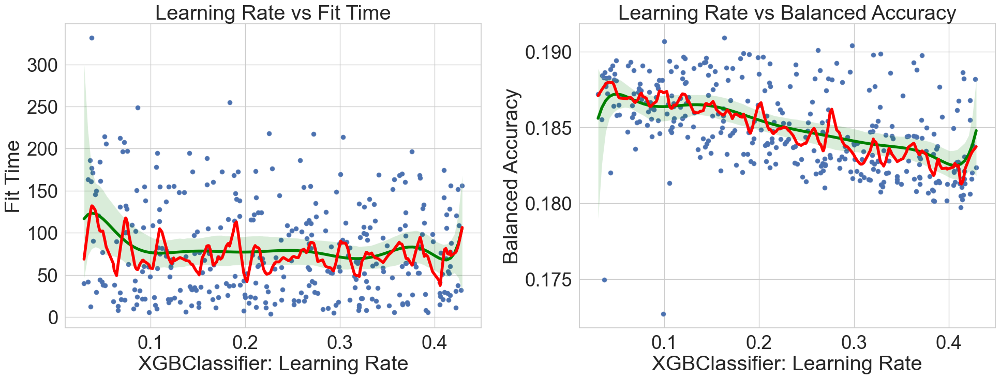

 - Gráfico de dispersión de Max Depth(XGBClassifier) frente a Fit Time y Balanced Accuracy


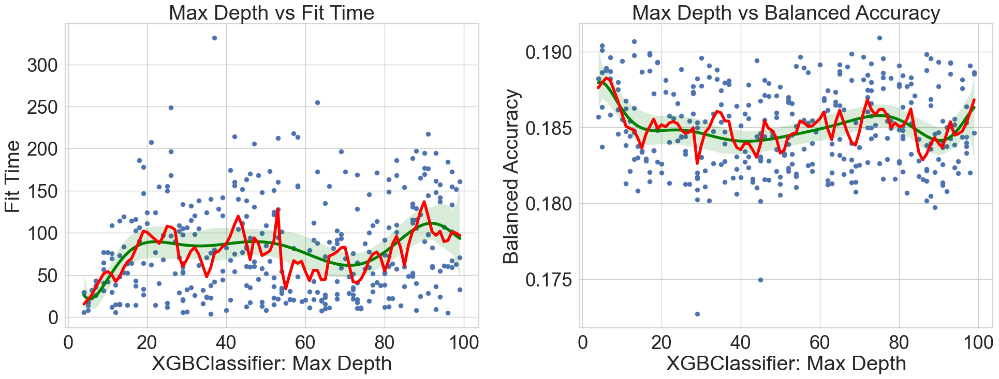

 - Gráfico de dispersión de Max Leaves(XGBClassifier) frente a Fit Time y Balanced Accuracy


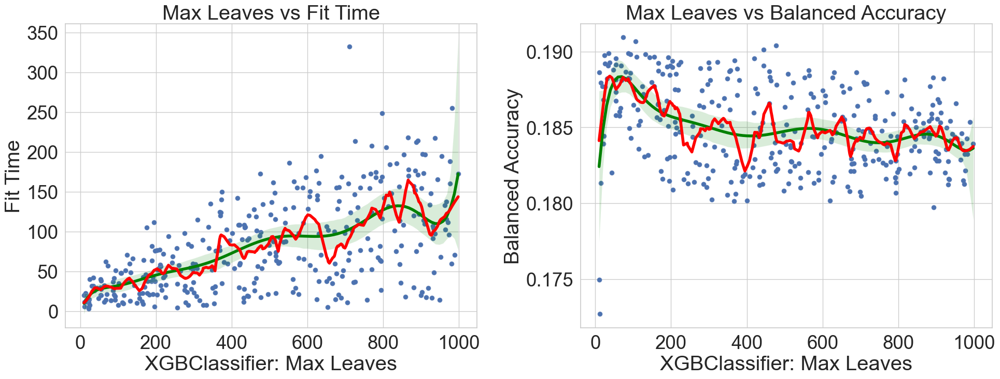

 - Gráfico de dispersión de N Estimators(XGBClassifier) frente a Fit Time y Balanced Accuracy


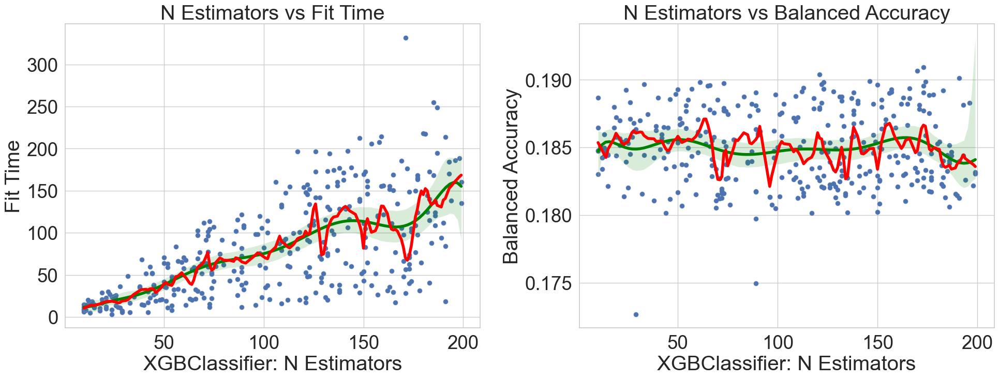

In [63]:
file_path = "analisis\\n_bins-10_uniform__XGBClassifier_df.csv"
algorithm = file_path.replace("analisis\\n_bins-10_uniform__", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
df = df[df['max_leaves'] >= 10]
print(df.shape)
df_to_word(df, f'10-bins_{algorithm}', orderer_by="balanced_accuracy")
#plot_and_save_scatterplots_median(df, algorithm=algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, regression=False)

(700, 11)
 - Gráfico de dispersión de Class Weight(HistGradientBoostingClassifier) frente a Fit Time y Balanced Accuracy


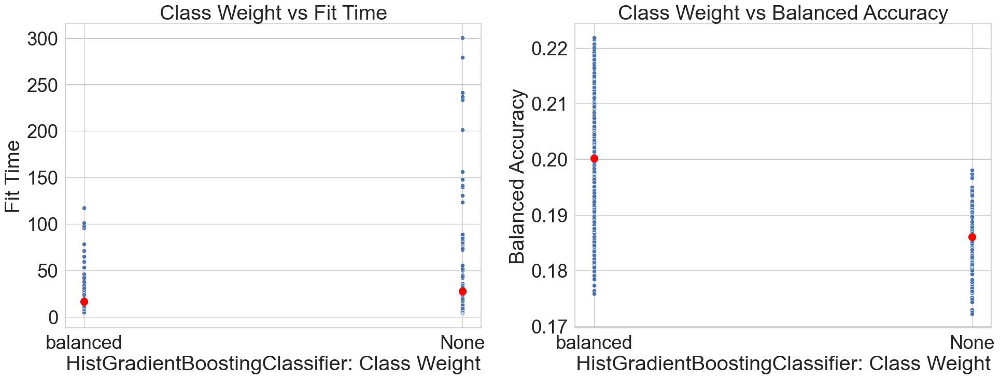

 - Gráfico de dispersión de Learning Rate(HistGradientBoostingClassifier) frente a Fit Time y Balanced Accuracy


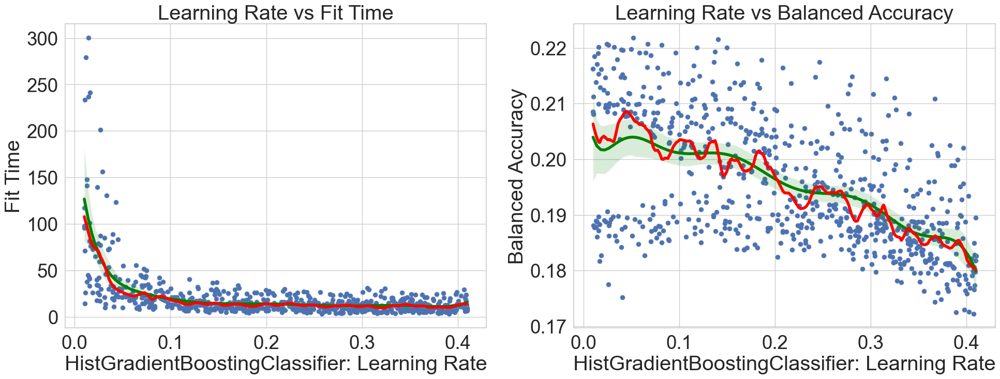

 - Gráfico de dispersión de Max Depth(HistGradientBoostingClassifier) frente a Fit Time y Balanced Accuracy


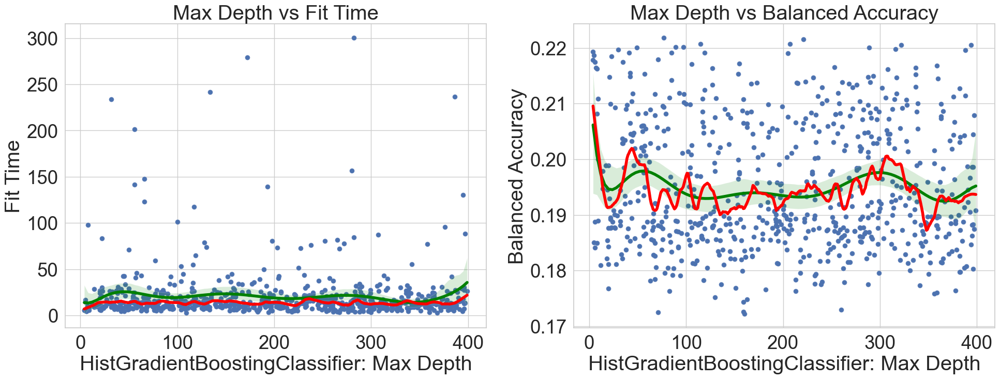

 - Gráfico de dispersión de Max Iter(HistGradientBoostingClassifier) frente a Fit Time y Balanced Accuracy


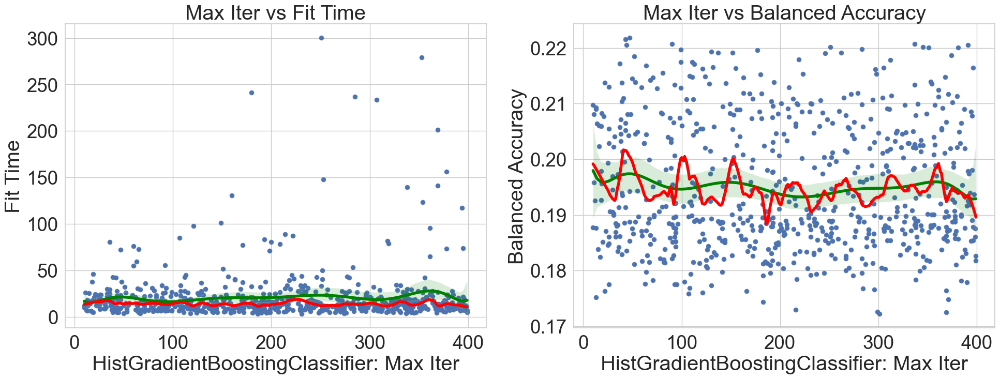

 - Gráfico de dispersión de Max Leaf Nodes(HistGradientBoostingClassifier) frente a Fit Time y Balanced Accuracy


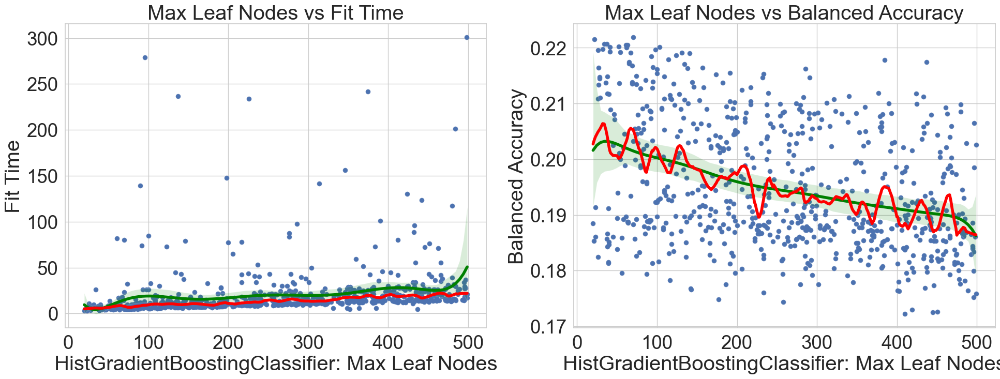

In [64]:
file_path = "analisis\\n_bins-10_uniform__HistGradientBoostingClassifier_df.csv"
algorithm = file_path.replace("analisis\\n_bins-10_uniform__", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, f'10-bins_{algorithm}', orderer_by="balanced_accuracy")
#plot_and_save_scatterplots_median(df, algorithm=algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, regression=False)

(527, 10)
 - Gráfico de dispersión de Class Weight(DecisionTreeClassifier) frente a Fit Time y Balanced Accuracy


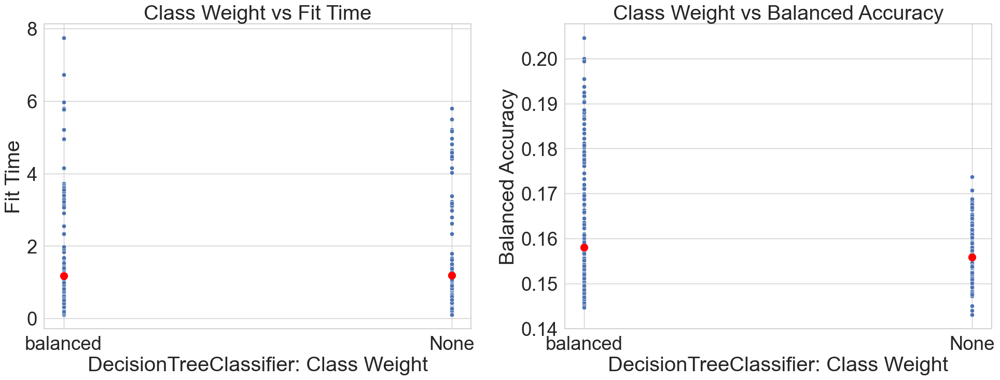

 - Gráfico de dispersión de Max Depth(DecisionTreeClassifier) frente a Fit Time y Balanced Accuracy


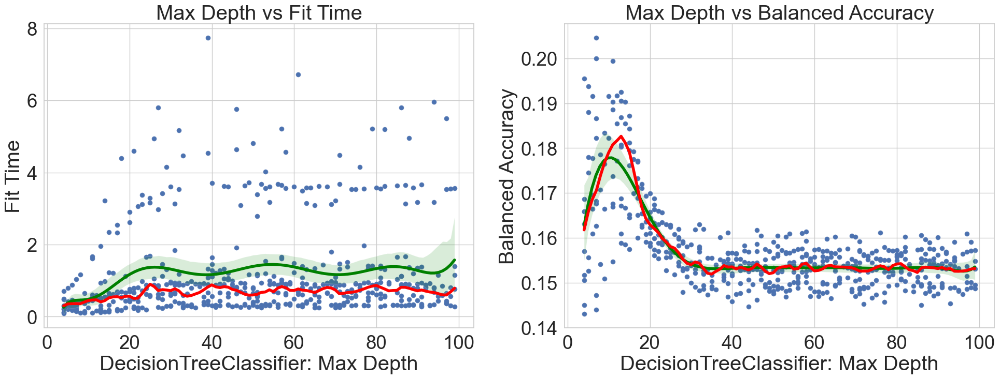

 - Gráfico de dispersión de Max Features(DecisionTreeClassifier) frente a Fit Time y Balanced Accuracy


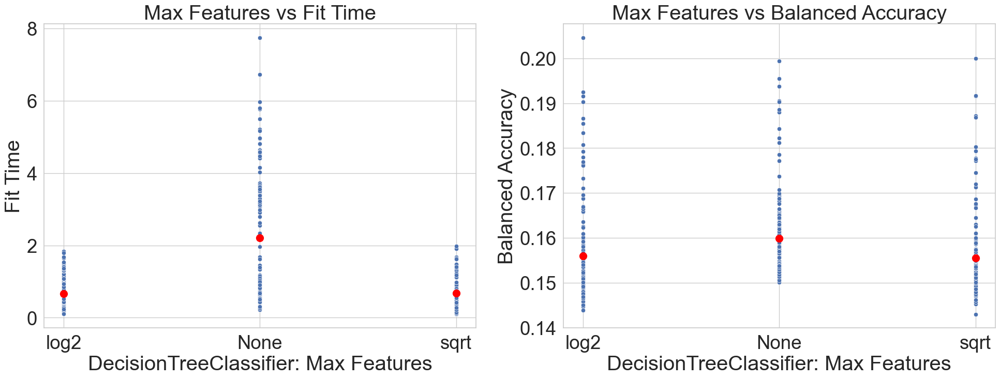

 - Gráfico de dispersión de Splitter(DecisionTreeClassifier) frente a Fit Time y Balanced Accuracy


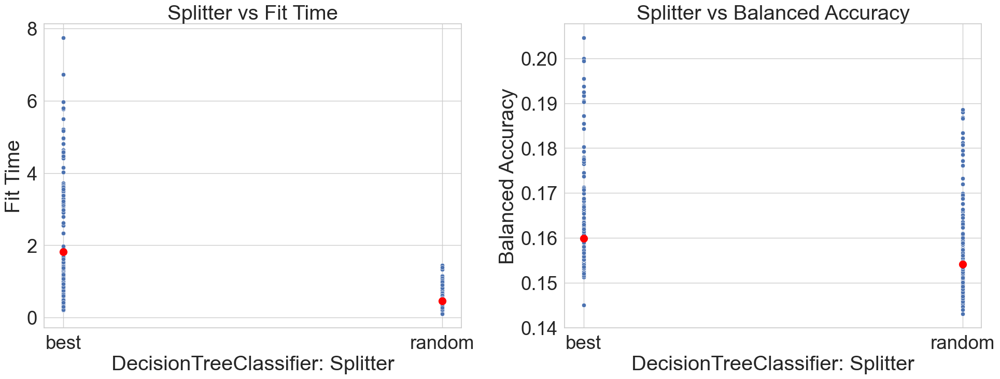

In [65]:
file_path = "analisis\\n_bins-10_uniform__DecisionTreeClassifier_df.csv"
algorithm = file_path.replace("analisis\\n_bins-10_uniform__", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, f'10-bins_{algorithm}', orderer_by="balanced_accuracy")
#plot_and_save_scatterplots_median(df, algorithm=algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, regression=False)

(700, 10)
 - Gráfico de dispersión de C(LinearSVC) frente a Fit Time y Balanced Accuracy


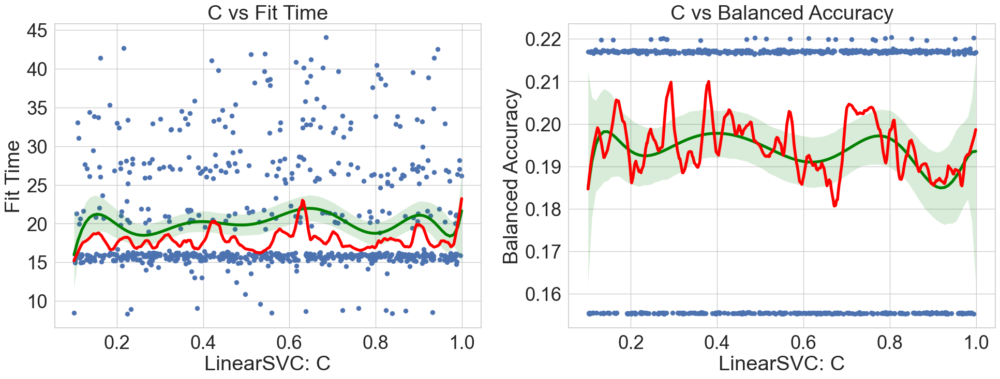

 - Gráfico de dispersión de Class Weight(LinearSVC) frente a Fit Time y Balanced Accuracy


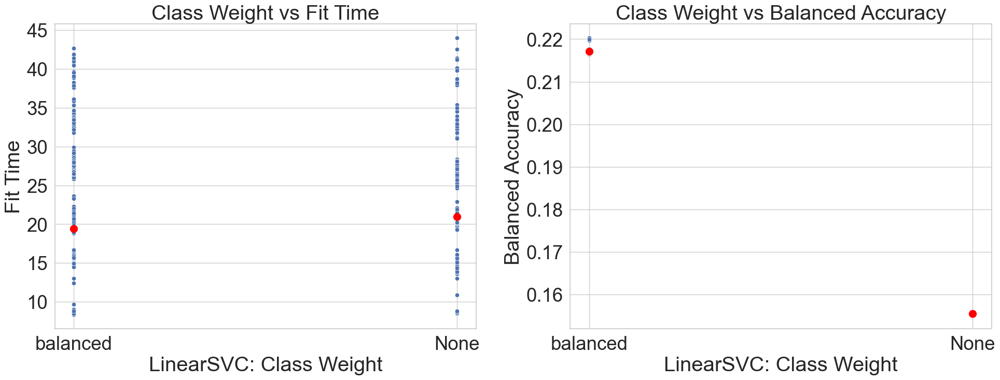

 - Gráfico de dispersión de Dual(LinearSVC) frente a Fit Time y Balanced Accuracy


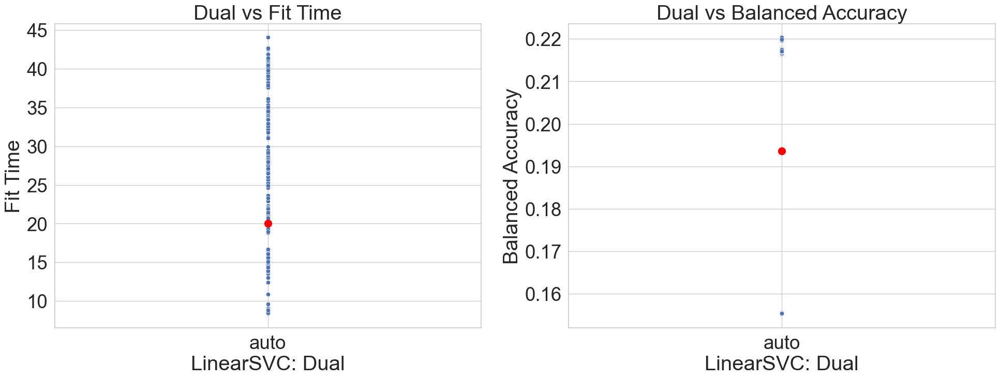

 - Gráfico de dispersión de Max Iter(LinearSVC) frente a Fit Time y Balanced Accuracy


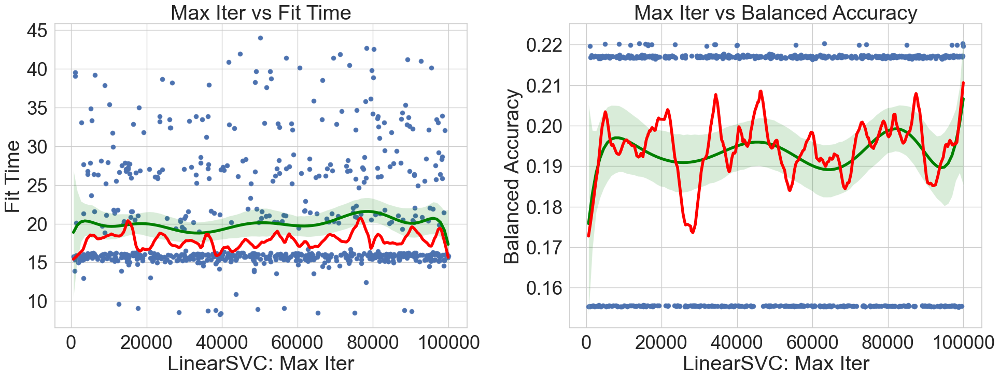

In [66]:
file_path = "analisis\\n_bins-10_uniform__LinearSVC_df.csv"
algorithm = file_path.replace("analisis\\n_bins-10_uniform__", "").replace("_df.csv", "")
globals()[f'df_{algorithm}'] = pd.read_csv(file_path)
df = pd.read_csv(file_path)
print(df.shape)
df_to_word(df, f'10-bins_{algorithm}', orderer_by="balanced_accuracy")
#plot_and_save_scatterplots_median(df, algorithm=algorithm)
plot_and_save_scatterplots_median_and_reg_pol(df, algorithm=algorithm, frac=0.05, polynomial_degree=10, regression=False)

In [ ]:
import pandas as pd
df = pd.read_csv('ruta_del_archivo.csv')

df1 = df.groupby('algoritmo').mean()

In [9]:

import pandas as pd
df = pd.read_csv('train-test_models\\resultados_metricas_regresion.csv')
excel_file = f'train-test_models\\resultados_metricas_regresion.xlsx'
df.to_excel(excel_file, index=False)
df = pd.read_csv('train-test_models\\5-bins-uniform\\resultados_metricas_clasificacion.csv')
excel_file = f'train-test_models\\5-bins-uniform\\resultados_metricas_clasificacion.xlsx'
df.to_excel(excel_file, index=False)
df = pd.read_csv('train-test_models\\10-bins-uniform\\resultados_metricas_clasificacion.csv')
excel_file = f'train-test_models\\10-bins-uniform\\resultados_metricas_clasificacion.xlsx'
df.to_excel(excel_file, index=False)

In [11]:
import pandas as pd
df = pd.read_csv('cross_val_models\\resultados_metricas_regresion.csv')
excel_file = f'cross_val_models\\resultados_metricas_regresion.xlsx'
df1 = df.groupby('Modelo', as_index=False).mean()
df1.to_excel(excel_file, index=False)
df = pd.read_csv('cross_val_models\\5-bins-uniform\\resultados_metricas_clasificacion.csv')
excel_file = f'cross_val_models\\5-bins-uniform\\resultados_metricas_clasificacion.xlsx'
df1 = df.groupby('Modelo', as_index=False).mean()
df1.to_excel(excel_file, index=False)
df = pd.read_csv('cross_val_models\\10-bins-uniform\\resultados_metricas_clasificacion.csv')
excel_file = f'cross_val_models\\10-bins-uniform\\resultados_metricas_clasificacion.xlsx'
df1 = df.groupby('Modelo', as_index=False).mean()
df1.to_excel(excel_file, index=False)

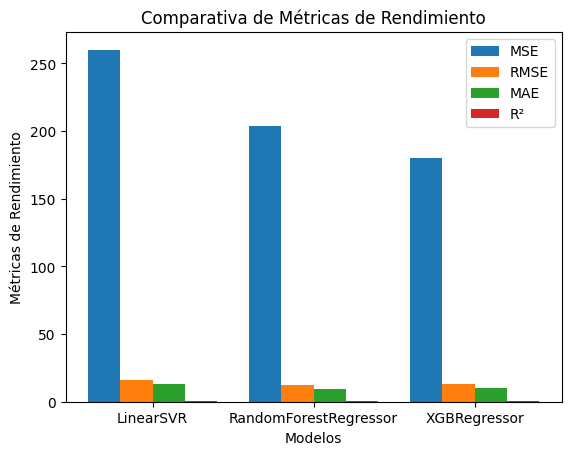

In [2]:
import matplotlib.pyplot as plt
import numpy as np

modelos = ['LinearSVR', 'RandomForestRegressor', 'XGBRegressor']
mse = [260.183, 203.8204, 180.456]
rmse = [16.130, 12.265, 13.432]
mae = [12.826, 9.567, 10.234]
r2 = [0.227, 0.556, 0.476]

x = np.arange(len(modelos))
width = 0.2

fig, ax = plt.subplots()

rects1 = ax.bar(x - 1.5*width, mse, width, label='MSE')
rects2 = ax.bar(x - 0.5*width, rmse, width, label='RMSE')
rects3 = ax.bar(x + 0.5*width, mae, width, label='MAE')
rects4 = ax.bar(x + 1.5*width, r2, width, label='R²')

ax.set_xlabel('Modelos')
ax.set_ylabel('Métricas de Rendimiento')
ax.set_title('Comparativa de Métricas de Rendimiento')
ax.set_xticks(x)
ax.set_xticklabels(modelos)
ax.legend()

plt.show()

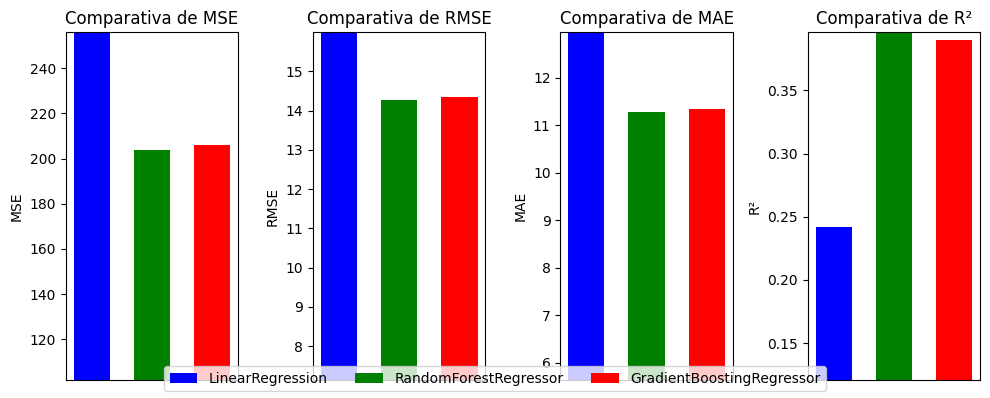

In [16]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Patch

modelos = ['LinearRegression', 'RandomForestRegressor', 'GradientBoostingRegressor']
mse = [255.9401, 203.8204, 205.8531]
rmse = [15.9981, 14.27653, 14.34754]
mae = [12.96098, 11.27817, 11.33808]
r2 = [0.241608, 0.39605, 0.390026]

x = np.arange(len(modelos)) 
width = 0.6

fig, axs = plt.subplots(1, 4, figsize=(10, 4))  

axs[0].bar(x, mse, width, color=['b', 'g', 'r'])
axs[1].bar(x, rmse, width, color=['b', 'g', 'r'])
axs[2].bar(x, mae, width, color=['b', 'g', 'r'])
axs[3].bar(x, r2, width, color=['b', 'g', 'r'])

metricas = ['MSE', 'RMSE', 'MAE', 'R²']
datos = [mse, rmse, mae, r2]
for i in range(4):
    axs[i].set_ylabel(metricas[i])
    axs[i].set_title('Comparativa de ' + metricas[i])
    axs[i].set_xticks([])
    axs[i].set_ylim([min(datos[i])/2, max(datos[i])])  
    

legend_elements = [Patch(facecolor='b', label='LinearRegression'),
                   Patch(facecolor='g', label='RandomForestRegressor'),
                   Patch(facecolor='r', label='GradientBoostingRegressor')]

fig.legend(handles=legend_elements, loc='lower center', ncol=len(modelos))

plt.tight_layout()
plt.show()

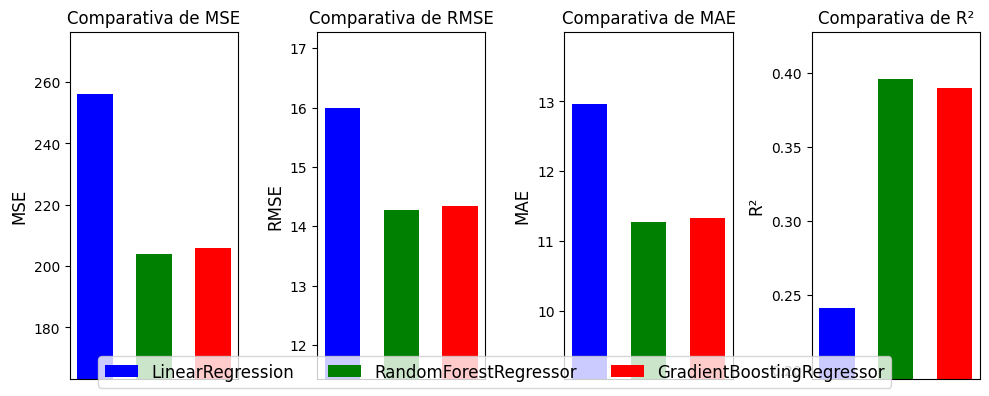

In [31]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Patch

modelos = ['LinearRegression', 'RandomForestRegressor', 'GradientBoostingRegressor']
mse = [255.9401, 203.8204, 205.8531]
rmse = [15.9981, 14.27653, 14.34754]
mae = [12.96098, 11.27817, 11.33808]
r2 = [0.241608, 0.39605, 0.390026]

x = np.arange(len(modelos))
width = 0.6

fig, axs = plt.subplots(1, 4, figsize=(10, 4))

axs[0].bar(x, mse, width, color=['b', 'g', 'r'])
axs[1].bar(x, rmse, width, color=['b', 'g', 'r'])
axs[2].bar(x, mae, width, color=['b', 'g', 'r'])
axs[3].bar(x, r2, width, color=['b', 'g', 'r'])

metricas = ['MSE', 'RMSE', 'MAE', 'R²']
datos = [mse, rmse, mae, r2]
for i in range(4):
    axs[i].set_ylabel(metricas[i], fontsize=12)
    axs[i].set_title('Comparativa de ' + metricas[i], fontsize=12)
    axs[i].set_xticks([])
    axs[i].set_ylim([min(datos[i])/1.25, max(datos[i])*1.08])

legend_elements = [Patch(facecolor='b', label='LinearRegression'),
                   Patch(facecolor='g', label='RandomForestRegressor'),
                   Patch(facecolor='r', label='GradientBoostingRegressor')]

fig.legend(handles=legend_elements, loc='lower center', ncol=len(modelos), fontsize=12)

plt.tight_layout()
plt.show()

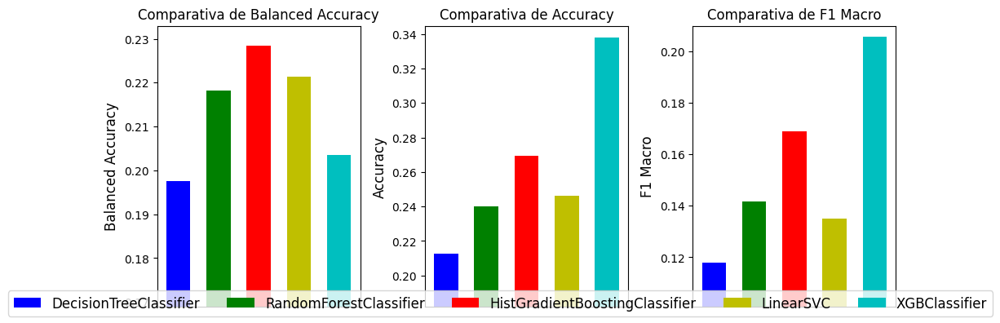

In [41]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Patch

modelos = ['DecisionTreeClassifier', 'RandomForestClassifier', 'HistGradientBoostingClassifier', 'LinearSVC', 'XGBClassifier']
balanced_accuracy = [0.197605, 0.218189, 0.228383, 0.221299, 0.203545]
accuracy = [0.212753, 0.239984, 0.269157, 0.246393, 0.337971]
f1_macro = [0.117933, 0.141692, 0.168827, 0.135085, 0.205734]

x = np.arange(len(modelos))
width = 0.6

fig, axs = plt.subplots(1, 3, figsize=(10, 4))

axs[0].bar(x, balanced_accuracy, width, color=['b', 'g', 'r', 'y', 'c'])
axs[1].bar(x, accuracy, width, color=['b', 'g', 'r', 'y', 'c'])
axs[2].bar(x, f1_macro, width, color=['b', 'g', 'r', 'y', 'c'])

metricas = ['Balanced Accuracy', 'Accuracy', 'F1 Macro']
datos = [balanced_accuracy, accuracy, f1_macro]
for i in range(3):
    axs[i].set_ylabel(metricas[i], fontsize=12)
    axs[i].set_title('Comparativa de ' + metricas[i], fontsize=12)
    axs[i].set_xticks([])
    axs[i].set_ylim([min(datos[i])/1.17, max(datos[i])*1.02])

legend_elements = [Patch(facecolor='b', label='DecisionTreeClassifier'),
                   Patch(facecolor='g', label='RandomForestClassifier'),
                   Patch(facecolor='r', label='HistGradientBoostingClassifier'),
                   Patch(facecolor='y', label='LinearSVC'),
                   Patch(facecolor='c', label='XGBClassifier')]

fig.legend(handles=legend_elements, loc='lower center', ncol=len(modelos), fontsize=12)

plt.tight_layout()
plt.show()

In [13]:
import pandas as pd

def resta_dataframes(df1, df2):

  if df1.shape != df2.shape or not all(df1.columns == df2.columns):
    raise ValueError("Los dataframes deben tener la misma estructura")

  columnas_numericas = [col for col in df1.columns if df1[col].dtype == 'int64' or df1[col].dtype == 'float64']

  df_resultado = pd.DataFrame()
  for col in columnas_numericas:
    df_resultado[col] = df1[col] - df2[col]

  columnas_no_numericas = [col for col in df1.columns if col not in columnas_numericas]
  df_resultado = pd.concat([df1[columnas_no_numericas], df_resultado], axis=1)

  return df_resultado

df1 = df = pd.read_excel("cross_val_models\\resultados_metricas_regresion.xlsx")
df2 = df = pd.read_excel("cross_val_models\-resultados_metricas_regresion.xlsx")

df_resultado = resta_dataframes(df1, df2)
df_resultado.head(11)

,Modelo,MSE,RMSE,MAE,MAPE,R2,Explained_Variance
0,ElasticNet,-5.216909,-0.162215,-0.151102,-5767599927707,0.015463,0.015464
1,GradientBoostingRegressor,-0.010362,-0.000368,-0.000891,-2304308940891,0.000032,0.000032
2,HistGradientBoostingRegressor,0.103402,0.003564,0.002774,3173033179034,-0.000305,-0.000305
3,KNeighborsRegressor,-2.520200,-0.085328,-0.093718,-262519375843439,0.007180,0.006731
4,LGBMRegressor,-0.148890,-0.005071,-0.005342,-14749945347194,0.000155,0.000154
5,Lasso,-5.284291,-0.164318,-0.156034,-19124251312834,0.015662,0.015664
6,LinearRegression,-5.308287,-0.165067,-0.160952,-43000436157751,0.015734,0.015735
7,LinearSVR,-3.032829,-0.093446,-0.089268,-125350087243511,0.008719,0.009049
8,RandomForestRegressor,-0.103772,-0.003634,-0.002976,352931029874,0.000308,0.000307
9,Ridge,-5.455903,-0.169675,-0.166602,-47778132360003,0.015829,0.015830


In [11]:
df1 = df = pd.read_excel("cross_val_models\\10-bins-uniform\\resultados_metricas_clasificacion.xlsx")
df2 = df = pd.read_excel("cross_val_models\\10-bins-uniform\\-resultados_metricas_clasificacion.xlsx")
df_resultado = resta_dataframes(df1, df2)
df_resultado.head(11)

,Modelo,Balanced_Accuracy,Accuracy,Precision_Macro,Recall_Macro,F1_Macro,Precision_Weighted,Recall_Weighted,F1_Weighted
0,DecisionTreeClassifier,-0.062052,-0.059429,-0.049960,-0.062052,-0.053719,-0.068533,-0.059429,-0.073347
1,HistGradientBoostingClassifier,-0.060616,-0.055191,-0.043902,-0.060616,-0.046105,-0.061301,-0.055191,-0.062533
2,LinearSVC,-0.050934,-0.058111,-0.046299,-0.050934,-0.045985,-0.064733,-0.058111,-0.066414
3,RandomForestClassifier,-0.058069,-0.052029,-0.039888,-0.058069,-0.045168,-0.057717,-0.052029,-0.063726
4,XGBClassifier,-0.042001,-0.062503,-0.054082,-0.042001,-0.043932,-0.066619,-0.062503,-0.064157


In [6]:
df1 = df = pd.read_excel("cross_val_models\\5-bins-uniform\\resultados_metricas_clasificacion.xlsx")
df2 = df = pd.read_excel("cross_val_models\\5-bins-uniform\\-resultados_metricas_clasificacion.xlsx")
df_resultado = resta_dataframes(df1, df2)
df_resultado.head(11)

,Modelo,Balanced_Accuracy,Accuracy,Precision_Macro,Recall_Macro,F1_Macro,Precision_Weighted,Recall_Weighted,F1_Weighted
0,DecisionTreeClassifier,0.102384,0.106087,0.084853,0.102384,0.094091,0.116639,0.106087,0.129906
1,HistGradientBoostingClassifier,0.105672,0.093509,0.075196,0.105672,0.077775,0.105744,0.093509,0.106027
2,LinearSVC,0.094047,0.108461,0.085316,0.094047,0.088557,0.115607,0.108461,0.121304
3,RandomForestClassifier,0.100544,0.089409,0.068834,0.100544,0.076446,0.100432,0.089409,0.110424
4,XGBClassifier,0.072159,0.108119,0.090424,0.072159,0.075167,0.115119,0.108119,0.111041


In [9]:
excel_file = f'cross_val_models\\5-bins-uniform\\comparativa-resultados_metricas_clasificacion.xlsx'
df_resultado.to_excel(excel_file, index=False)